## <a>**Download Data**

In [ ]:
%%capture
!pip install kaggle

In [ ]:
import os
os.environ['KAGGLE_USERNAME'] = 'mohamedsebaie'
os.environ['KAGGLE_KEY'] = '8a89dd7fd8e7be6ea00ada59faa6425b'

In [ ]:
!kaggle datasets download -d agrigorev/clothing-dataset-full

100% 6.50G/6.50G [04:43<00:00, 25.0MB/s]
100% 6.50G/6.50G [04:43<00:00, 24.7MB/s]


In [ ]:
%%capture
!unzip clothing-dataset-full.zip

## <a>**Required Imports**

In [ ]:
# Copied from:
# https://weepingfish.github.io/2020/07/22/0722-suppress-tensorflow-warnings/

# Filter tensorflow version warnings
import os
# https://stackoverflow.com/questions/40426502/is-there-a-way-to-suppress-the-messages-tensorflow-prints/40426709
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "3"  # or any {'0', '1', '2'}
import warnings

# https://stackoverflow.com/questions/15777951/how-to-suppress-pandas-future-warning
warnings.simplefilter(action="ignore", category=FutureWarning)
warnings.simplefilter(action="ignore", category=Warning)
import tensorflow as tf
tf.get_logger().setLevel("INFO")
tf.autograph.set_verbosity(0)
import logging

tf.get_logger().setLevel(logging.ERROR)

In [ ]:
# importing the tensorflow package
tf.test.is_built_with_cuda()
tf.test.is_gpu_available(cuda_only=False, min_cuda_compute_capability=None)

True

In [ ]:
from tensorflow import keras
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_datasets as tfds

tfds.disable_progress_bar()
import cv2
import gc
import seaborn as sns
import random
import os
import sys
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pylab import rcParams
from PIL import Image
from datetime import datetime
import matplotlib.pyplot as plt
from skimage.transform import resize
import matplotlib
get_ipython().run_line_magic('matplotlib', 'inline')
matplotlib.rc('figure', figsize = (20, 8))
matplotlib.rc('font', size = 14)
matplotlib.rc('axes.spines', top = False, right = False)
matplotlib.rc('axes', grid = False)
matplotlib.rc('axes', facecolor = 'white')
from keras.preprocessing.image import ImageDataGenerator
from keras.layers import Dense, Activation, Flatten, Dropout, BatchNormalization
from keras.layers import Conv2D, MaxPooling2D
from keras import regularizers, optimizers
import pandas as pd
import numpy as np
from sklearn.model_selection import KFold, StratifiedKFold, train_test_split
import tensorflow
import tensorflow.keras.backend as K
from tensorflow.keras.utils import to_categorical, plot_model

from keras import layers,utils
from keras.models import Sequential,load_model
from tensorflow.keras.optimizers import Adam, RMSprop
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import Callback, EarlyStopping, ModelCheckpoint,ReduceLROnPlateau
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Concatenate, BatchNormalization, Dense, Dropout, Activation, Flatten,Conv2D,MaxPooling2D, MaxPool2D,Add, add
from tensorflow.keras.layers import Conv2D, MaxPooling2D,LeakyReLU, Dense, InputLayer,Dropout, Activation, Flatten,Input, BatchNormalization, Conv2D, MaxPool2D, GlobalMaxPool2D,GlobalAveragePooling2D
from tensorflow.keras.applications import VGG16, MobileNet, ResNet50, InceptionV3, Xception, VGG19,ResNet101
from tensorflow.keras.layers import Multiply
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import ReLU
# from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import confusion_matrix, classification_report
from tensorflow import keras
from tensorflow.keras import models
from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from sklearn.metrics import hamming_loss,label_ranking_loss,accuracy_score,coverage_error, average_precision_score, f1_score
from keras import layers, models

In [ ]:
try:  # detect TPUs
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver.connect()  # TPU detection
    strategy = tf.distribute.TPUStrategy(tpu)
except ValueError:  # detect GPUs
    tpu = False
    strategy = (
        tf.distribute.get_strategy()
    )  # default strategy that works on CPU and single GPU
print("Number of Accelerators: ", strategy.num_replicas_in_sync)

Number of Accelerators:  1


In [ ]:
# Random Seed 
seed_constant = 777
np.random.seed(seed_constant)
random.seed(seed_constant)
tf.random.set_seed(seed_constant)

## <a>**Load and Read the images Data**

### <a>**Load the Data**

In [ ]:
dfImages= pd.read_csv('images.csv')

In [ ]:
dfImages

,image,sender_id,label,kids
0,4285fab0-751a-4b74-8e9b-43af05deee22,124,Not sure,False
1,ea7b6656-3f84-4eb3-9099-23e623fc1018,148,T-Shirt,False
2,00627a3f-0477-401c-95eb-92642cbe078d,94,Not sure,False
3,ea2ffd4d-9b25-4ca8-9dc2-bd27f1cc59fa,43,T-Shirt,False
4,3b86d877-2b9e-4c8b-a6a2-1d87513309d0,189,Shoes,False
...,...,...,...,...
5398,dfd4079d-967b-4b3e-8574-fbac11b58103,204,Shorts,False
5399,befa14be-8140-4faf-8061-1039947e329d,204,Body,True
5400,5379356a-40ee-4890-b416-2336a7d84061,310,Shorts,False
5401,65507fb8-3456-4c15-b53e-d1b03bf71a59,204,Shoes,False


### <a>**Basic Inspection**

In [ ]:
dfImages.shape

(5403, 4)

In [ ]:
dfImages.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5403 entries, 0 to 5402
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   image      5403 non-null   object
 1   sender_id  5403 non-null   int64 
 2   label      5403 non-null   object
 3   kids       5403 non-null   bool  
dtypes: bool(1), int64(1), object(2)
memory usage: 132.0+ KB


In [ ]:
dfImages.image.value_counts()

4285fab0-751a-4b74-8e9b-43af05deee22    1
f0e2a88a-9286-44a8-95bd-2e21559c3b24    1
9fba5065-dc5e-40b8-9548-40d2d498d7a2    1
450fa7d0-f241-4284-b883-fe374cb2d559    1
4f92ab1e-87fb-4d81-b3fe-469d1630f3df    1
                                       ..
b4ac2cc0-22f0-4659-82c3-835fa1347660    1
b8d21d3f-7316-4de3-a087-214a42c5e096    1
59225f02-287d-4f5a-8b0a-a9749ddd9d9d    1
ad7af6f6-e6a6-4950-b3c8-eb498ea70726    1
32b99302-cec7-4dec-adfa-3d4029674209    1
Name: image, Length: 5403, dtype: int64

In [ ]:
dfImages.label.value_counts()

T-Shirt       1011
Longsleeve     699
Pants          692
Shoes          431
Shirt          378
Dress          357
Outwear        312
Shorts         308
Not sure       228
Hat            171
Skirt          155
Polo           120
Undershirt     118
Blazer         109
Hoodie         100
Body            69
Other           67
Top             43
Blouse          23
Skip            12
Name: label, dtype: int64

In [ ]:
dfImages.kids.value_counts()

False    4927
True      476
Name: kids, dtype: int64

In [ ]:
dfImages["kids"] = dfImages["kids"].astype(int)

In [ ]:
dfImages['kids']

0       0
1       0
2       0
3       0
4       0
       ..
5398    0
5399    1
5400    0
5401    0
5402    0
Name: kids, Length: 5403, dtype: int64

<Axes: xlabel='kids', ylabel='count'>

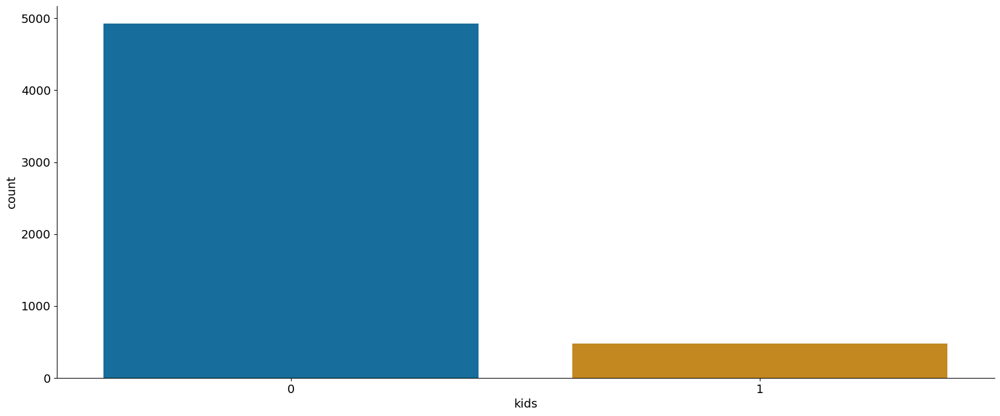

In [ ]:
sns.countplot(x = dfImages['kids'], data = dfImages, palette = 'colorblind')

In [ ]:
matplotlib.rc('figure', figsize = (14, 6))

<Axes: xlabel='count', ylabel='label'>

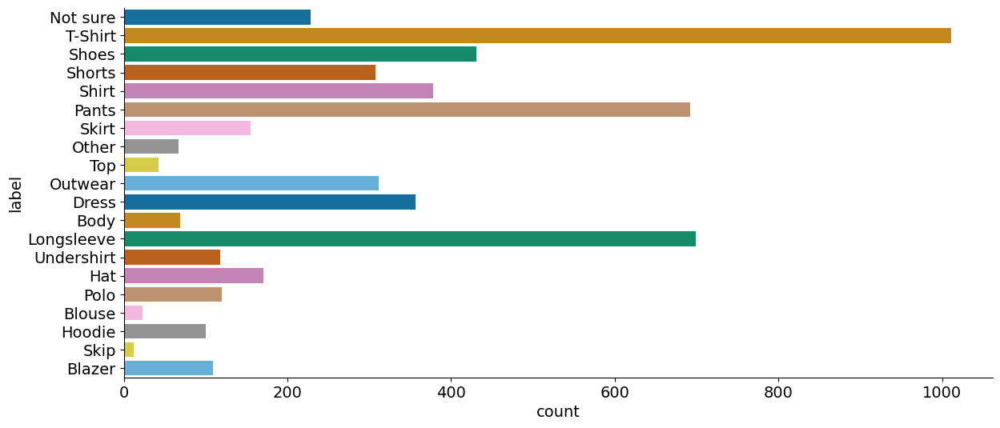

In [ ]:
sns.countplot(y= dfImages['label'], data = dfImages, palette = 'colorblind')

## <a>**Intial Preprocessing for the data**

In [ ]:
dfImages['image'].iloc()[0]

'4285fab0-751a-4b74-8e9b-43af05deee22'

In [ ]:
# image_path = '/content/images_original/'+ dfImages['image'].iloc()[0]+".jpg" 
# image = Image.open(image_path)
# image

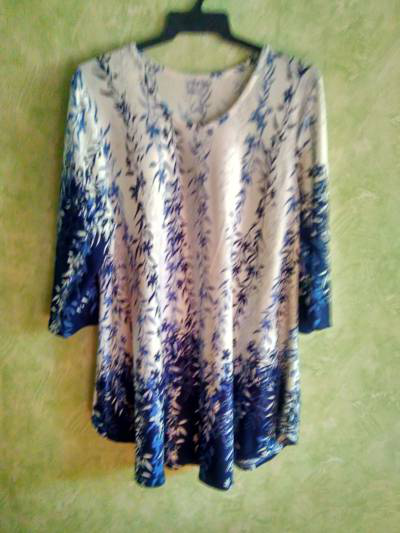

In [ ]:
image_path = '/content/images_compressed/'+ dfImages['image'].iloc()[0]+".jpg" 
image = Image.open(image_path)
image

In [ ]:
dfImages['image'] = 'images_compressed/'+ dfImages['image']+".jpg" 

In [ ]:
dfImages

,image,sender_id,label,kids
0,images_compressed/4285fab0-751a-4b74-8e9b-43af...,124,Not sure,0
1,images_compressed/ea7b6656-3f84-4eb3-9099-23e6...,148,T-Shirt,0
2,images_compressed/00627a3f-0477-401c-95eb-9264...,94,Not sure,0
3,images_compressed/ea2ffd4d-9b25-4ca8-9dc2-bd27...,43,T-Shirt,0
4,images_compressed/3b86d877-2b9e-4c8b-a6a2-1d87...,189,Shoes,0
...,...,...,...,...
5398,images_compressed/dfd4079d-967b-4b3e-8574-fbac...,204,Shorts,0
5399,images_compressed/befa14be-8140-4faf-8061-1039...,204,Body,1
5400,images_compressed/5379356a-40ee-4890-b416-2336...,310,Shorts,0
5401,images_compressed/65507fb8-3456-4c15-b53e-d1b0...,204,Shoes,0


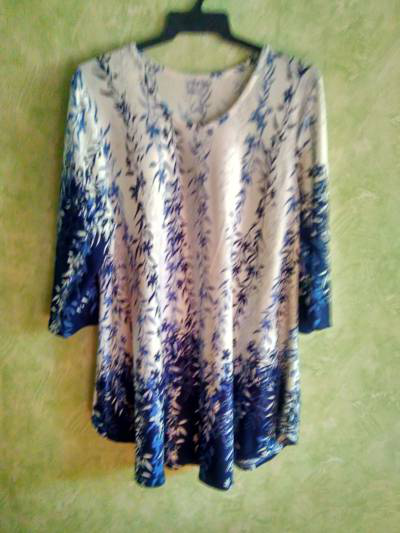

In [ ]:
image_path = dfImages['image'].iloc()[0]
image = Image.open(image_path)
image

**Some of the items are still labeled “Not sure”, “Others”, or “Skip”, and there could be labeling errors.So we will remove them and hold them out as a test for visualization.** 

reference is: https://medium.com/data-science-insider/clothing-dataset-5b72cd7c3f1f

In [ ]:
values_to_remove = ['Not sure', 'Other', 'Skip']
dfImages_v2 = dfImages[~dfImages['label'].isin(values_to_remove)]


In [ ]:
dfImages_v2.label.value_counts()/len(dfImages_v2) * 100

T-Shirt       19.839089
Longsleeve    13.716641
Pants         13.579278
Shoes          8.457614
Shirt          7.417582
Dress          7.005495
Outwear        6.122449
Shorts         6.043956
Hat            3.355573
Skirt          3.041601
Polo           2.354788
Undershirt     2.315542
Blazer         2.138932
Hoodie         1.962323
Body           1.354003
Top            0.843799
Blouse         0.451334
Name: label, dtype: float64

In [ ]:
dfImages_v2.kids.value_counts()/len(dfImages_v2) * 100

0    91.365777
1     8.634223
Name: kids, dtype: float64

In [ ]:
matplotlib.rc('figure', figsize = (14, 6))

<Axes: xlabel='kids', ylabel='count'>

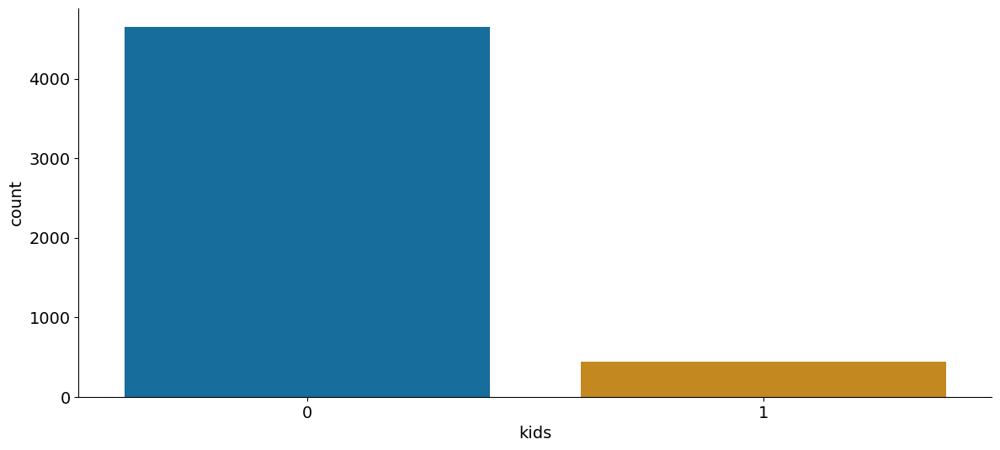

In [ ]:
sns.countplot(x = dfImages_v2['kids'], data = dfImages_v2, palette = 'colorblind')

<Axes: xlabel='count', ylabel='label'>

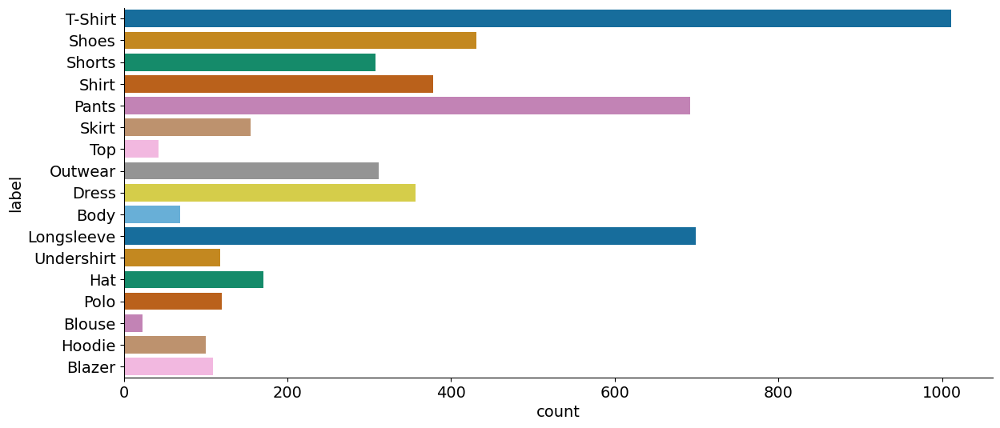

In [ ]:
sns.countplot(y= dfImages_v2['label'], data = dfImages_v2, palette = 'colorblind')

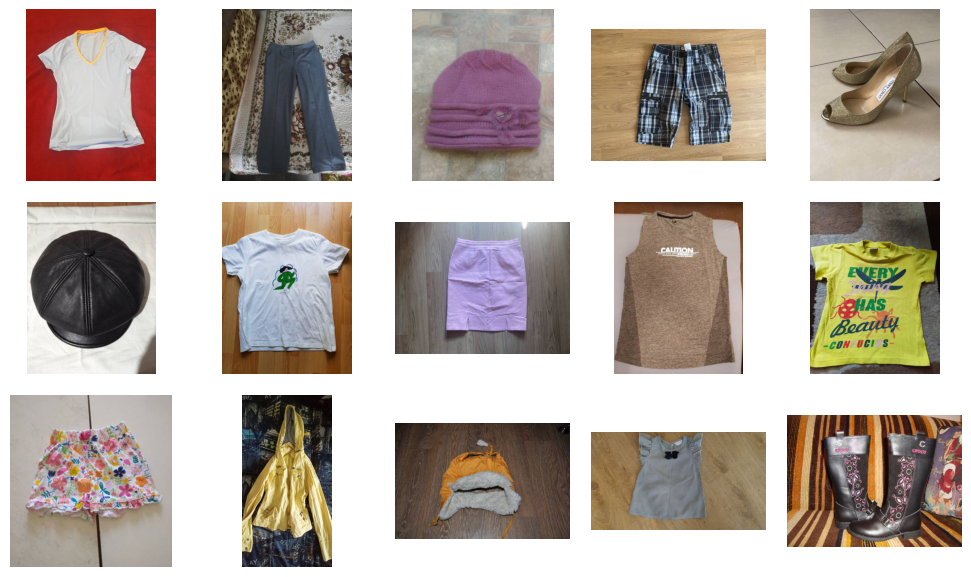

In [ ]:
import os
import random
from PIL import Image
import matplotlib.pyplot as plt

# Directory containing the images
image_dir = '/content/images_compressed'

# Get a list of all image file names in the directory
image_files = os.listdir(image_dir)

# Select and display 15 random images
num_images_to_show = 15

fig, axs = plt.subplots(3, 5, figsize=(10, 6))

for i in range(num_images_to_show):
    # Select a random image from the list
    random_image_file = random.choice(image_files)

    # Load the image using PIL
    image_path = os.path.join(image_dir, random_image_file)
    image = Image.open(image_path)

    # Display the image on a subplot
    ax = axs[i // 5, i % 5]
    ax.imshow(image)
    ax.axis('off')

plt.tight_layout()
plt.show()


## <a>**Train Test Split and Data Genetrators**

In [ ]:
df_train, df_test = train_test_split(dfImages_v2,test_size=0.2, random_state=777, shuffle=True, stratify=dfImages_v2.label)
df_val, df_test = train_test_split(df_test,test_size=0.5, random_state=777, shuffle=True, stratify=df_test.label)

In [ ]:
#Data Augmentation 
train_datagen = ImageDataGenerator(rescale=1./255., horizontal_flip=True)
val_datagen   = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_dataframe(
    dataframe=df_train,               # The DataFrame containing image paths and class labels
    x_col='image',  # The column name containing the image paths
    y_col='label',       # The column name containing the class labels
    target_size=(224, 224),     # The desired image size
    batch_size=64,      # The batch size for training
    class_mode='categorical'    # The class mode, set to 'categorical' for multiclass classification
)

val_generator = val_datagen.flow_from_dataframe(
    dataframe=df_val,               # The DataFrame containing image paths and class labels
    x_col='image',  # The column name containing the image paths
    y_col='label',       # The column name containing the class labels
    target_size=(224, 224),     # The desired image size
    batch_size=64,      # The batch size for training
    class_mode='categorical'    # The class mode, set to 'categorical' for multiclass classification
)

test_generator = val_datagen.flow_from_dataframe(
    dataframe=df_test,               # The DataFrame containing image paths and class labels
    x_col='image',  # The column name containing the image paths
    y_col='label',       # The column name containing the class labels
    target_size=(224, 224),     # The desired image size
    batch_size=64,      # The batch size for training
    class_mode='categorical'    # The class mode, set to 'categorical' for multiclass classification
)

Found 4076 validated image filenames belonging to 17 classes.
Found 510 validated image filenames belonging to 17 classes.
Found 510 validated image filenames belonging to 17 classes.


In [ ]:
train_steps = train_generator.n // train_generator.batch_size
validation_steps = val_generator.n // val_generator.batch_size
test_steps = test_generator.n // test_generator.batch_size
print(train_steps)
print(validation_steps)
print(test_steps)

63
7
7


In [ ]:
classes= list(test_generator.class_indices.keys())
classes

['Blazer',
 'Blouse',
 'Body',
 'Dress',
 'Hat',
 'Hoodie',
 'Longsleeve',
 'Outwear',
 'Pants',
 'Polo',
 'Shirt',
 'Shoes',
 'Shorts',
 'Skirt',
 'T-Shirt',
 'Top',
 'Undershirt']

## <a>**Approach 1 `From Scratch CNN Model`**

### ***CNN Model Network***

In [ ]:
def conv_block(model,number_of_filters, kernel_size, padding='valid', dropout=False,d=0.5,pooling=False, first=False,input_shape=(32,32,3)):
  if first:
    model.add(Conv2D(number_of_filters, kernel_size=kernel_size,padding=padding, activation='relu', input_shape=input_shape))
    model.add(BatchNormalization())
    return model

  model.add(Conv2D(number_of_filters, kernel_size=kernel_size, padding=padding, activation='relu'))
  model.add(BatchNormalization())

  if pooling:
    model.add(MaxPooling2D(pool_size=(2, 2)))

  if dropout:
    model.add(Dropout(d))

  return model

In [ ]:
model_name="Clothing_Articles_Model"
model = Sequential(name = model_name)
conv_block(model,64,  3, first=True,input_shape=(224,224,3))
conv_block(model,64,  3)
conv_block(model,64,  5, padding='same', dropout=True,d=0.2,pooling=True)


conv_block(model,128, 3)
conv_block(model,128, 3)
conv_block(model,128, 5, padding='same', dropout=True,d=0.2,pooling=True)

conv_block(model,256, 3, dropout=True,d=0.2,pooling=True)

model.add(Flatten())
model.add(Dense(256))
model.add(BatchNormalization())
model.add(Dense(128))
model.add(BatchNormalization())
model.add(Dense(17, activation='softmax'))

model.summary()

Model: "Clothing_Articles_Model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 64)      1792      
                                                                 
 batch_normalization (BatchN  (None, 222, 222, 64)     256       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 220, 220, 64)      36928     
                                                                 
 batch_normalization_1 (Batc  (None, 220, 220, 64)     256       
 hNormalization)                                                 
                                                                 
 conv2d_2 (Conv2D)           (None, 220, 220, 64)      102464    
                                                                 
 batch_normalization_2 (Batc  (None, 220, 2

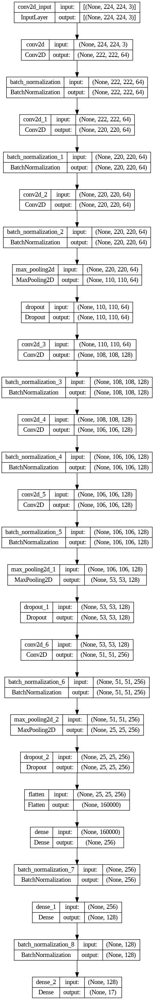

In [ ]:
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True) 

### ***CNN Training***

In [ ]:
optimizer = RMSprop(learning_rate=0.001)
model.compile(loss='categorical_crossentropy',optimizer=optimizer,metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', patience=50,verbose=1,factor=0.2)
checkpoint = ModelCheckpoint('models/'+model_name+'.h5', monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
early_stop = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=200)

In [ ]:
epochs = 200
batch_size = 64
history = model.fit(train_generator,steps_per_epoch= train_steps,epochs=epochs,validation_data=val_generator,
                    validation_steps=validation_steps,verbose = 1,callbacks=[reduce_lr, early_stop, checkpoint])

Epoch 1/200
63/63 [==============================] - ETA: 0s - loss: 2.3799 - accuracy: 0.3504
Epoch 1: val_accuracy improved from -inf to 0.15848, saving model to models/Clothing_Articles_Model.h5
63/63 [==============================] - 174s 1s/step - loss: 2.3799 - accuracy: 0.3504 - val_loss: 3.0041 - val_accuracy: 0.1585 - lr: 0.0010
Epoch 2/200
63/63 [==============================] - ETA: 0s - loss: 1.5461 - accuracy: 0.5371
Epoch 2: val_accuracy improved from 0.15848 to 0.29018, saving model to models/Clothing_Articles_Model.h5
63/63 [==============================] - 20s 315ms/step - loss: 1.5461 - accuracy: 0.5371 - val_loss: 3.2802 - val_accuracy: 0.2902 - lr: 0.0010
Epoch 3/200
63/63 [==============================] - ETA: 0s - loss: 1.2041 - accuracy: 0.6331
Epoch 3: val_accuracy improved from 0.29018 to 0.36830, saving model to models/Clothing_Articles_Model.h5
63/63 [==============================] - 20s 315ms/step - loss: 1.2041 - accuracy: 0.6331 - val_loss: 2.0902 - v

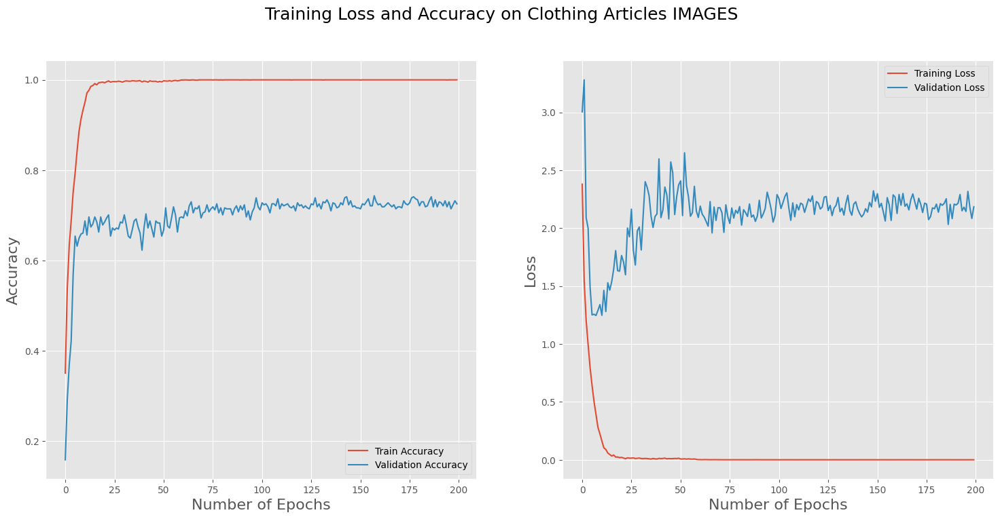

In [ ]:
plt.figure(figsize=(18,8))
plt.style.use("ggplot")
title = "Training Loss and Accuracy on Clothing Articles IMAGES "
plt.suptitle(title, fontsize=18)
plt.subplot(1,2,1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.xlabel('Number of Epochs', fontsize=16)
plt.ylabel('Accuracy', fontsize=16)

plt.subplot(1,2,2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.legend()
plt.xlabel('Number of Epochs', fontsize=16)
plt.ylabel('Loss', fontsize=16)


plt.show()

### **Evaluation on Test**

In [ ]:
valid_loss, valid_accuracy = model.evaluate(val_generator)
test_loss, test_accuracy   = model.evaluate(test_generator)
                           

print('Validation Accuracy: ', round((valid_accuracy * 100), 1), "%")
print('Test Accuracy: ', round((test_accuracy * 100), 1), "%")
print(" ")
print('Validation Loss: ', round(valid_loss, 1))
print('Test Loss: ', round(test_loss, 1))

8/8 [==============================] - 2s 263ms/step - loss: 2.4746 - accuracy: 0.6784
Validation Accuracy:  72.5 %
Test Accuracy:  67.8 %
 
Validation Loss:  2.2
Test Loss:  2.5


### **Save Keras Model to Drive**

In [ ]:
%cp -r /content/models/Clothing_Articles_Model.h5 /content/drive/MyDrive/Tahaluf_ML_Task

### ***`Confusion Matrix` and `Classification Report`***

#### Iterating over the test batches to Store the Data in `X_test_`, `y_test_true`

In [ ]:
test_generator.reset()
X_test_, y_test_true = [],[] 
for i in range(test_steps+1):
    X , y = next(test_generator)
    X_test_.extend(X) 
    y_test_true.extend(y)

In [ ]:
X_test_    = np.array(X_test_)
y_test_true= np.array(y_test_true)
print(X_test_.shape, y_test_true.shape)

(510, 224, 224, 3) (510, 17)


#### Predict on `X_test_`

In [ ]:
y_pred = model.predict(X_test_)

16/16 [==============================] - 2s 100ms/step


#### Confusion Matrix

In [ ]:
list(test_generator.class_indices.keys())

['Blazer',
 'Blouse',
 'Body',
 'Dress',
 'Hat',
 'Hoodie',
 'Longsleeve',
 'Outwear',
 'Pants',
 'Polo',
 'Shirt',
 'Shoes',
 'Shorts',
 'Skirt',
 'T-Shirt',
 'Top',
 'Undershirt']

In [ ]:
sns.set(rc={'figure.figsize':(11.7,8.27)})

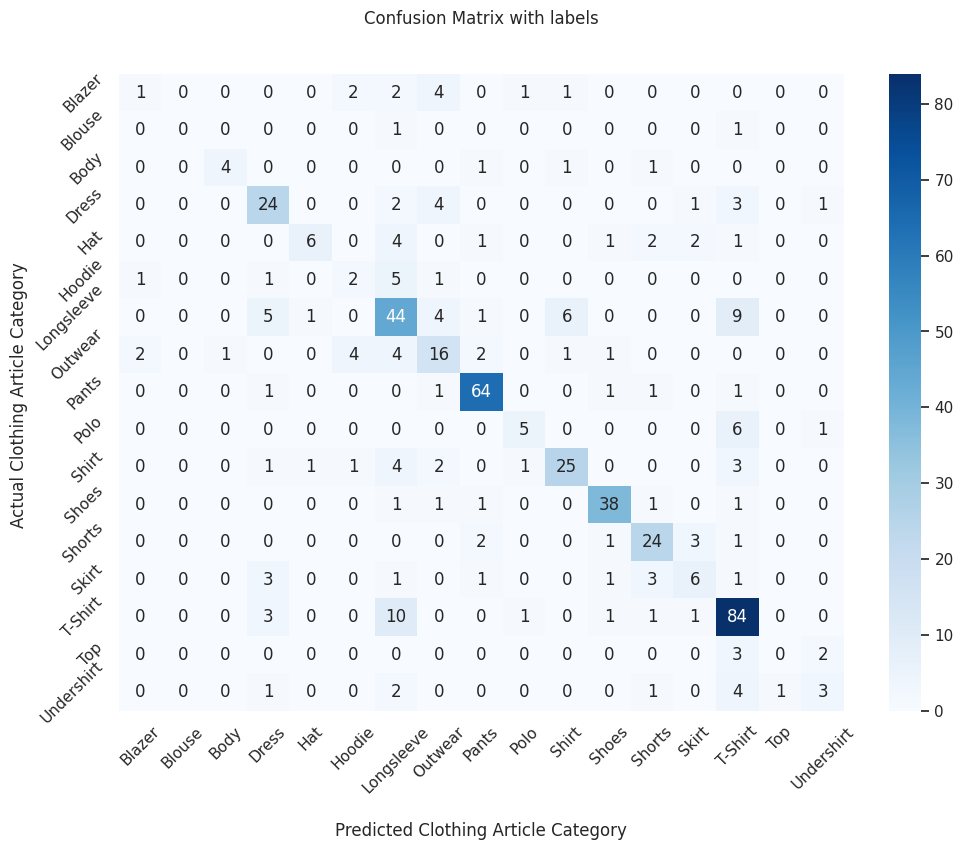

In [ ]:
confusionMatrix = confusion_matrix(np.argmax(y_test_true, axis=1), np.argmax(y_pred, axis=1))

ax = sns.heatmap(confusionMatrix, annot=True, cmap='Blues',fmt='g')

ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Clothing Article Category')
ax.set_ylabel('Actual Clothing Article Category ');

## Ticket labels - List must be in alphabetical order
ax.xaxis.set_ticklabels(list(test_generator.class_indices.keys()), rotation=45)
ax.yaxis.set_ticklabels(list(test_generator.class_indices.keys()), rotation=45)

## Display the visualization of the Confusion Matrix.
plt.show()

#### Classification Report

In [ ]:
print(classification_report(np.argmax(y_test_true, axis=1), np.argmax(y_pred, axis=1),target_names=list(test_generator.class_indices.keys()), zero_division=0))

              precision    recall  f1-score   support

      Blazer       0.25      0.09      0.13        11
      Blouse       0.00      0.00      0.00         2
        Body       0.80      0.57      0.67         7
       Dress       0.62      0.69      0.65        35
         Hat       0.75      0.35      0.48        17
      Hoodie       0.22      0.20      0.21        10
  Longsleeve       0.55      0.63      0.59        70
     Outwear       0.48      0.52      0.50        31
       Pants       0.88      0.93      0.90        69
        Polo       0.62      0.42      0.50        12
       Shirt       0.74      0.66      0.69        38
       Shoes       0.86      0.88      0.87        43
      Shorts       0.71      0.77      0.74        31
       Skirt       0.46      0.38      0.41        16
     T-Shirt       0.71      0.83      0.77       101
         Top       0.00      0.00      0.00         5
  Undershirt       0.43      0.25      0.32        12

    accuracy              

### ***Display Images from the Test Dataset***

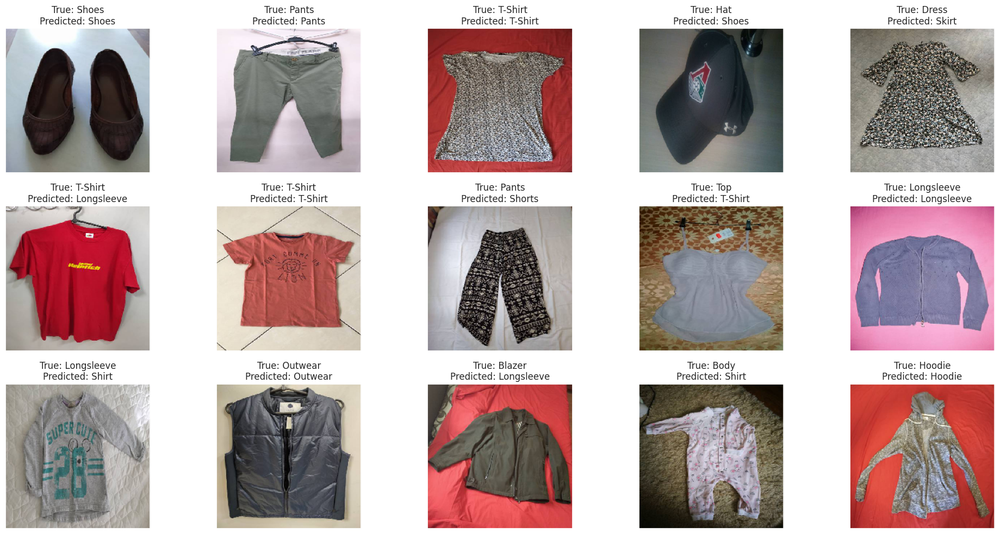

In [ ]:
# Display 15 picture of the dataset with their labels
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(20, 10),
                        subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
  ax.imshow(X_test_[i])
  ax.set_title(f"True: {list(test_generator.class_indices.keys())[list(test_generator.class_indices.values()).index(np.argmax(y_test_true, axis=1)[i])]}\nPredicted: {list(test_generator.class_indices.keys())[list(test_generator.class_indices.values()).index(np.argmax(y_pred, axis=1)[i])]}")
plt.tight_layout()
plt.show();



---



---



---



## <a>**Approach 2 `ResNet Pretrained Model`**

### ***CNN Model Network***

In [ ]:
model_name="Clothing_Articles_Res_Model"
res = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224,3))
res.trainable=False
dense = res.output 
dense = Flatten()(dense) 
dropout = Dropout(.3)(dense)
output = Dense(17,activation='softmax', name=model_name)(dropout)
model_Res = Model(inputs=res.input, outputs=[output],)
model_Res.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_2[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

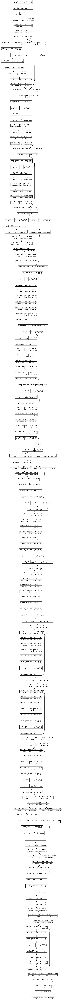

In [ ]:
plot_model(model_Res, to_file='Res_model_plot.png', show_shapes=True, show_layer_names=True) 

### ***CNN Training***

In [ ]:
optimizer = Adam(learning_rate=0.001)
model_Res.compile(loss='categorical_crossentropy',optimizer=optimizer,metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', patience=10,verbose=1,factor=0.2)
checkpoint = ModelCheckpoint('models/'+model_name+'.h5', monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
early_stop = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=20)

In [ ]:
epochs = 50
batch_size = 64
history = model_Res.fit(train_generator,steps_per_epoch= train_steps,epochs=epochs,validation_data=val_generator,
                    validation_steps=validation_steps,verbose = 1,callbacks=[reduce_lr, early_stop, checkpoint])

Epoch 1/50
63/63 [==============================] - ETA: 0s - loss: 5.5886 - accuracy: 0.2109
Epoch 1: val_accuracy improved from -inf to 0.31473, saving model to models/Clothing_Articles_Res_Model.h5
63/63 [==============================] - 25s 334ms/step - loss: 5.5886 - accuracy: 0.2109 - val_loss: 2.5628 - val_accuracy: 0.3147 - lr: 0.0010
Epoch 2/50
63/63 [==============================] - ETA: 0s - loss: 2.4247 - accuracy: 0.3522
Epoch 2: val_accuracy improved from 0.31473 to 0.45982, saving model to models/Clothing_Articles_Res_Model.h5
63/63 [==============================] - 20s 313ms/step - loss: 2.4247 - accuracy: 0.3522 - val_loss: 2.0531 - val_accuracy: 0.4598 - lr: 0.0010
Epoch 3/50
63/63 [==============================] - ETA: 0s - loss: 2.4608 - accuracy: 0.3786
Epoch 3: val_accuracy did not improve from 0.45982
63/63 [==============================] - 19s 303ms/step - loss: 2.4608 - accuracy: 0.3786 - val_loss: 2.7816 - val_accuracy: 0.4576 - lr: 0.0010
Epoch 4/50
63/6

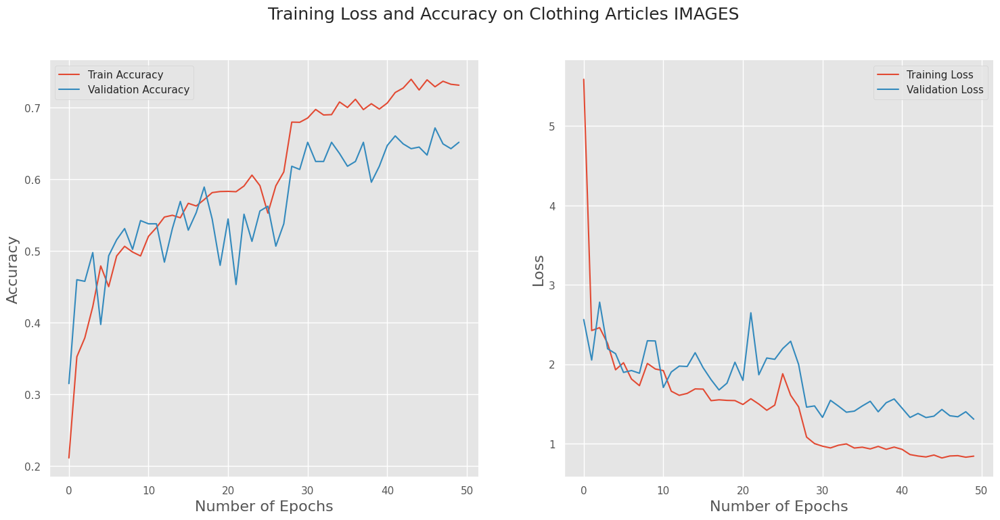

In [ ]:
plt.figure(figsize=(18,8))
plt.style.use("ggplot")
title = "Training Loss and Accuracy on Clothing Articles IMAGES "
plt.suptitle(title, fontsize=18)
plt.subplot(1,2,1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.xlabel('Number of Epochs', fontsize=16)
plt.ylabel('Accuracy', fontsize=16)

plt.subplot(1,2,2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.legend()
plt.xlabel('Number of Epochs', fontsize=16)
plt.ylabel('Loss', fontsize=16)


plt.show()

### **Evaluation on Test**

In [ ]:
valid_loss, valid_accuracy = model_Res.evaluate(val_generator)
test_loss, test_accuracy   = model_Res.evaluate(test_generator)
                           

print('Validation Accuracy: ', round((valid_accuracy * 100), 1), "%")
print('Test Accuracy: ', round((test_accuracy * 100), 1), "%")
print(" ")
print('Validation Loss: ', round(valid_loss, 1))
print('Test Loss: ', round(test_loss, 1))

8/8 [==============================] - 2s 259ms/step - loss: 1.4069 - accuracy: 0.6039
Validation Accuracy:  64.5 %
Test Accuracy:  60.4 %
 
Validation Loss:  1.4
Test Loss:  1.4


### **Save Keras Model to Drive**

In [ ]:
%cp -r /content/models/Clothing_Articles_Res_Model.h5 /content/drive/MyDrive/Tahaluf_ML_Task

### ***`Confusion Matrix` and `Classification Report`***

#### Iterating over the test batches to Store the Data in `X_test_`, `y_test_true`

In [ ]:
test_generator.reset()
X_test_, y_test_true = [],[] 
for i in range(test_steps+1):
    X , y = next(test_generator)
    X_test_.extend(X) 
    y_test_true.extend(y)

In [ ]:
X_test_    = np.array(X_test_)
y_test_true= np.array(y_test_true)
print(X_test_.shape, y_test_true.shape)

(510, 224, 224, 3) (510, 17)


#### Predict on `X_test_`

In [ ]:
y_pred = model_Res.predict(X_test_)

16/16 [==============================] - 2s 39ms/step


#### Confusion Matrix

In [ ]:
list(test_generator.class_indices.keys())

['Blazer',
 'Blouse',
 'Body',
 'Dress',
 'Hat',
 'Hoodie',
 'Longsleeve',
 'Outwear',
 'Pants',
 'Polo',
 'Shirt',
 'Shoes',
 'Shorts',
 'Skirt',
 'T-Shirt',
 'Top',
 'Undershirt']

In [ ]:
sns.set(rc={'figure.figsize':(11.7,8.27)})

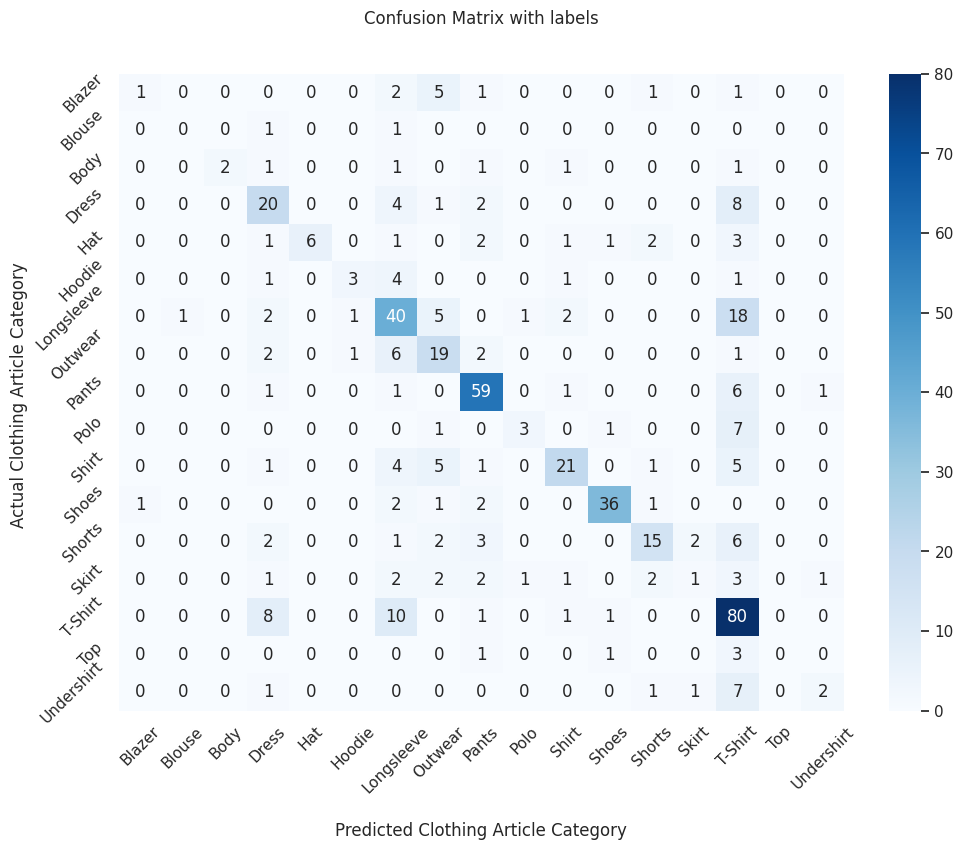

In [ ]:
confusionMatrix = confusion_matrix(np.argmax(y_test_true, axis=1), np.argmax(y_pred, axis=1))

ax = sns.heatmap(confusionMatrix, annot=True, cmap='Blues',fmt='g')

ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Clothing Article Category')
ax.set_ylabel('Actual Clothing Article Category ');

## Ticket labels - List must be in alphabetical order
ax.xaxis.set_ticklabels(list(test_generator.class_indices.keys()), rotation=45)
ax.yaxis.set_ticklabels(list(test_generator.class_indices.keys()), rotation=45)

## Display the visualization of the Confusion Matrix.
plt.show()

#### Classification Report

In [ ]:
print(classification_report(np.argmax(y_test_true, axis=1), np.argmax(y_pred, axis=1),target_names=list(test_generator.class_indices.keys()), zero_division=0))

              precision    recall  f1-score   support

      Blazer       0.50      0.09      0.15        11
      Blouse       0.00      0.00      0.00         2
        Body       1.00      0.29      0.44         7
       Dress       0.48      0.57      0.52        35
         Hat       1.00      0.35      0.52        17
      Hoodie       0.60      0.30      0.40        10
  Longsleeve       0.51      0.57      0.54        70
     Outwear       0.46      0.61      0.53        31
       Pants       0.77      0.86      0.81        69
        Polo       0.60      0.25      0.35        12
       Shirt       0.72      0.55      0.63        38
       Shoes       0.90      0.84      0.87        43
      Shorts       0.65      0.48      0.56        31
       Skirt       0.25      0.06      0.10        16
     T-Shirt       0.53      0.79      0.64       101
         Top       0.00      0.00      0.00         5
  Undershirt       0.50      0.17      0.25        12

    accuracy              

### ***Display Images from the Test Dataset***

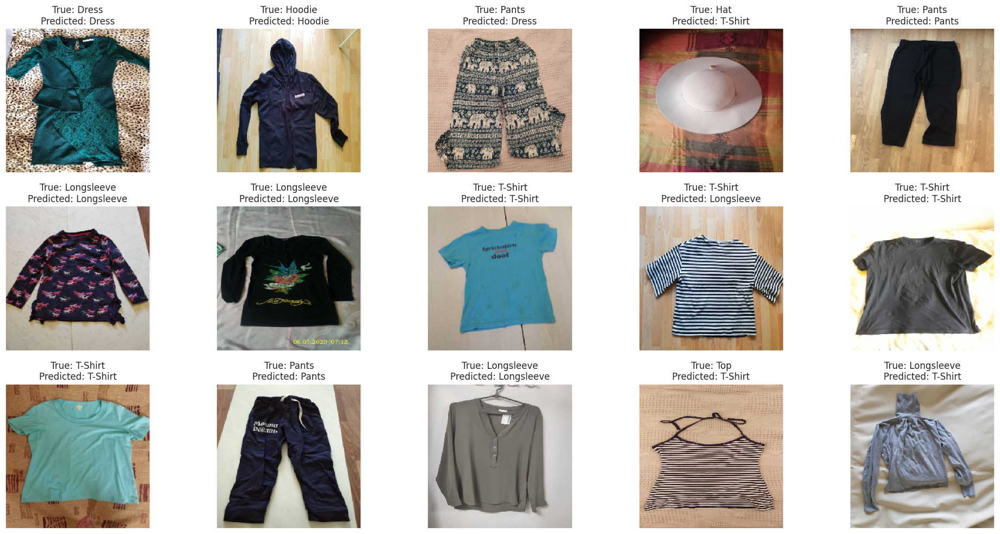

In [ ]:
# Display 15 picture of the dataset with their labels
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(20, 10),
                        subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
  ax.imshow(X_test_[i])
  ax.set_title(f"True: {list(test_generator.class_indices.keys())[list(test_generator.class_indices.values()).index(np.argmax(y_test_true, axis=1)[i])]}\nPredicted: {list(test_generator.class_indices.keys())[list(test_generator.class_indices.values()).index(np.argmax(y_pred, axis=1)[i])]}")
plt.tight_layout()
plt.show();



---



---



---



## <a>**Approach 3 `ResNet Pretrained Model` for Top 10 Classes**

In [ ]:
dfImages_v2.label.value_counts()

T-Shirt       1011
Longsleeve     699
Pants          692
Shoes          431
Shirt          378
Dress          357
Outwear        312
Shorts         308
Hat            171
Skirt          155
Polo           120
Undershirt     118
Blazer         109
Hoodie         100
Body            69
Top             43
Blouse          23
Name: label, dtype: int64

In [ ]:
dfImages_v2.shape

(5096, 4)

In [ ]:
top10_classes = dfImages_v2['label'].value_counts().index[:10]
top10_classes

Index(['T-Shirt', 'Longsleeve', 'Pants', 'Shoes', 'Shirt', 'Dress', 'Outwear',
       'Shorts', 'Hat', 'Skirt'],
      dtype='object')

In [ ]:
dfImages_top10 = dfImages_v2[dfImages_v2.label.isin(top10_classes)]

In [ ]:
dfImages_top10.label.value_counts()

T-Shirt       1011
Longsleeve     699
Pants          692
Shoes          431
Shirt          378
Dress          357
Outwear        312
Shorts         308
Hat            171
Skirt          155
Name: label, dtype: int64

In [ ]:
dfImages_top10.shape

(4514, 4)

In [ ]:
df_train_top10, df_test_top10 = train_test_split(dfImages_top10,test_size=0.2, random_state=777, shuffle=True, stratify=dfImages_top10.label)
df_val_top10, df_test_top10 = train_test_split(df_test_top10,test_size=0.5, random_state=777, shuffle=True, stratify=df_test_top10.label)

In [ ]:
train_generator_top10 = train_datagen.flow_from_dataframe(
    dataframe=df_train_top10,         # The DataFrame containing image paths and class labels
    x_col='image',                    # The column name containing the image paths
    y_col='label',                    # The column name containing the class labels
    target_size=(224, 224),           # The desired image size
    batch_size=64,                    # The batch size for training
    class_mode='categorical'          # The class mode, set to 'categorical' for multiclass classification
)

val_generator_top10 = val_datagen.flow_from_dataframe(
    dataframe=df_val_top10,             
    x_col='image',                 
    y_col='label',                
    target_size=(224, 224),       
    batch_size=64,                  
    class_mode='categorical'        
)

test_generator_top10 = val_datagen.flow_from_dataframe(
    dataframe=df_test_top10,              
    x_col='image',  
    y_col='label',       
    target_size=(224, 224),     
    batch_size=64,     
    class_mode='categorical'    
)

Found 3611 validated image filenames belonging to 10 classes.
Found 451 validated image filenames belonging to 10 classes.
Found 452 validated image filenames belonging to 10 classes.


In [ ]:
train_steps_top10 = train_generator_top10.n // train_generator_top10.batch_size
validation_steps_top10 = val_generator_top10.n // val_generator_top10.batch_size
test_steps_top10 = test_generator_top10.n // test_generator_top10.batch_size
print(train_steps_top10)
print(validation_steps_top10)
print(test_steps_top10)

56
7
7


In [ ]:
classes_top10= list(test_generator_top10.class_indices.keys())
classes_top10

['Dress',
 'Hat',
 'Longsleeve',
 'Outwear',
 'Pants',
 'Shirt',
 'Shoes',
 'Shorts',
 'Skirt',
 'T-Shirt']

### ***CNN Model Network***

In [ ]:
model_name="Clothing_Articles_Res_Model2"
res = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224,3))
res.trainable=False
dense = res.output 
dense = Flatten()(dense) 
dropout = Dropout(.3)(dense)
output = Dense(10,activation='softmax', name=model_name)(dropout)
model_Res = Model(inputs=res.input, outputs=[output],)
model_Res.summary()

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_7[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                            

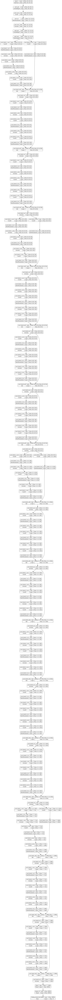

In [ ]:
plot_model(model_Res, to_file='Res_model_plot.png', show_shapes=True, show_layer_names=True) 

### ***CNN Training***

In [ ]:
optimizer = Adam(learning_rate=0.001)
model_Res.compile(loss='categorical_crossentropy',optimizer=optimizer,metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', patience=10,verbose=1,factor=0.2)
checkpoint = ModelCheckpoint('models/'+model_name+'.h5', monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
early_stop = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=20)

In [ ]:
epochs = 50
batch_size = 64
history = model_Res.fit(train_generator_top10,steps_per_epoch= train_steps_top10,epochs=epochs,validation_data=val_generator_top10,
                    validation_steps=validation_steps_top10,verbose = 1,callbacks=[reduce_lr, early_stop, checkpoint])

Epoch 1/50
56/56 [==============================] - ETA: 0s - loss: 5.1911 - accuracy: 0.2250
Epoch 1: val_accuracy improved from -inf to 0.27232, saving model to models/Clothing_Articles_Res_Model2.h5
56/56 [==============================] - 26s 390ms/step - loss: 5.1911 - accuracy: 0.2250 - val_loss: 2.3275 - val_accuracy: 0.2723 - lr: 0.0010
Epoch 2/50
56/56 [==============================] - ETA: 0s - loss: 2.0999 - accuracy: 0.3730
Epoch 2: val_accuracy improved from 0.27232 to 0.38170, saving model to models/Clothing_Articles_Res_Model2.h5
56/56 [==============================] - 19s 343ms/step - loss: 2.0999 - accuracy: 0.3730 - val_loss: 1.9170 - val_accuracy: 0.3817 - lr: 0.0010
Epoch 3/50
56/56 [==============================] - ETA: 0s - loss: 1.7322 - accuracy: 0.4542
Epoch 3: val_accuracy improved from 0.38170 to 0.52902, saving model to models/Clothing_Articles_Res_Model2.h5
56/56 [==============================] - 19s 339ms/step - loss: 1.7322 - accuracy: 0.4542 - val_lo

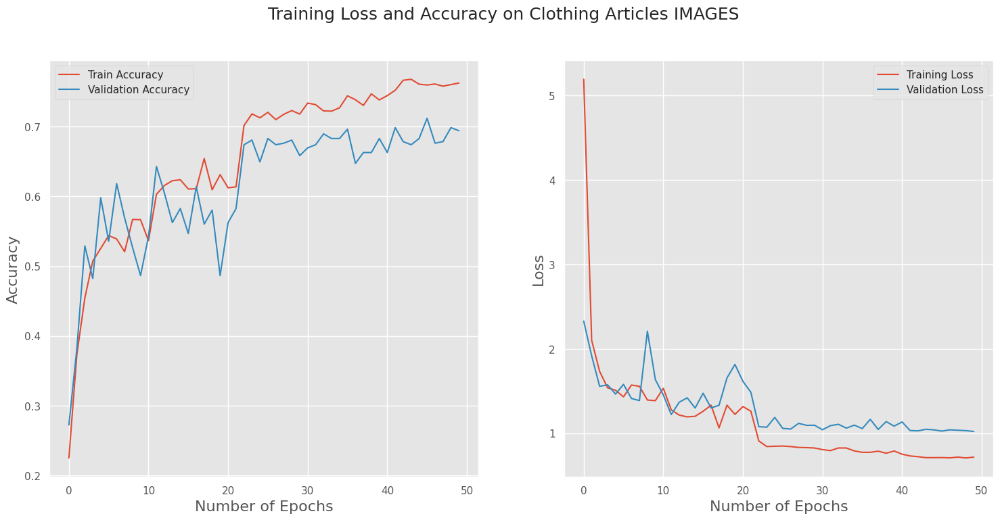

In [ ]:
plt.figure(figsize=(18,8))
plt.style.use("ggplot")
title = "Training Loss and Accuracy on Clothing Articles IMAGES "
plt.suptitle(title, fontsize=18)
plt.subplot(1,2,1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.xlabel('Number of Epochs', fontsize=16)
plt.ylabel('Accuracy', fontsize=16)

plt.subplot(1,2,2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.legend()
plt.xlabel('Number of Epochs', fontsize=16)
plt.ylabel('Loss', fontsize=16)


plt.show()

### **Evaluation on Test**

In [ ]:
valid_loss, valid_accuracy = model_Res.evaluate(val_generator_top10)
test_loss, test_accuracy   = model_Res.evaluate(test_generator_top10)
                           

print('Validation Accuracy: ', round((valid_accuracy * 100), 1), "%")
print('Test Accuracy: ', round((test_accuracy * 100), 1), "%")
print(" ")
print('Validation Loss: ', round(valid_loss, 1))
print('Test Loss: ', round(test_loss, 1))

8/8 [==============================] - 3s 359ms/step - loss: 1.0561 - accuracy: 0.6947
Validation Accuracy:  69.4 %
Test Accuracy:  69.5 %
 
Validation Loss:  1.0
Test Loss:  1.1


### **Save Keras Model to Drive**

In [ ]:
%cp -r /content/models/Clothing_Articles_Top10_Res_Model2.h5 /content/drive/MyDrive/Tahaluf_ML_Task

### ***`Confusion Matrix` and `Classification Report`***

#### Iterating over the test batches to Store the Data in `X_test_`, `y_test_true`

In [ ]:
test_generator_top10.reset()
X_test_, y_test_true = [],[] 
for i in range(test_steps+1):
    X , y = next(test_generator_top10)
    X_test_.extend(X) 
    y_test_true.extend(y)

In [ ]:
X_test_    = np.array(X_test_)
y_test_true= np.array(y_test_true)
print(X_test_.shape, y_test_true.shape)

(452, 224, 224, 3) (452, 10)


#### Predict on `X_test_`

In [ ]:
y_pred = model_Res.predict(X_test_)

15/15 [==============================] - 2s 34ms/step


#### Confusion Matrix

In [ ]:
list(test_generator_top10.class_indices.keys())

['Dress',
 'Hat',
 'Longsleeve',
 'Outwear',
 'Pants',
 'Shirt',
 'Shoes',
 'Shorts',
 'Skirt',
 'T-Shirt']

In [ ]:
sns.set(rc={'figure.figsize':(11.7,8.27)})

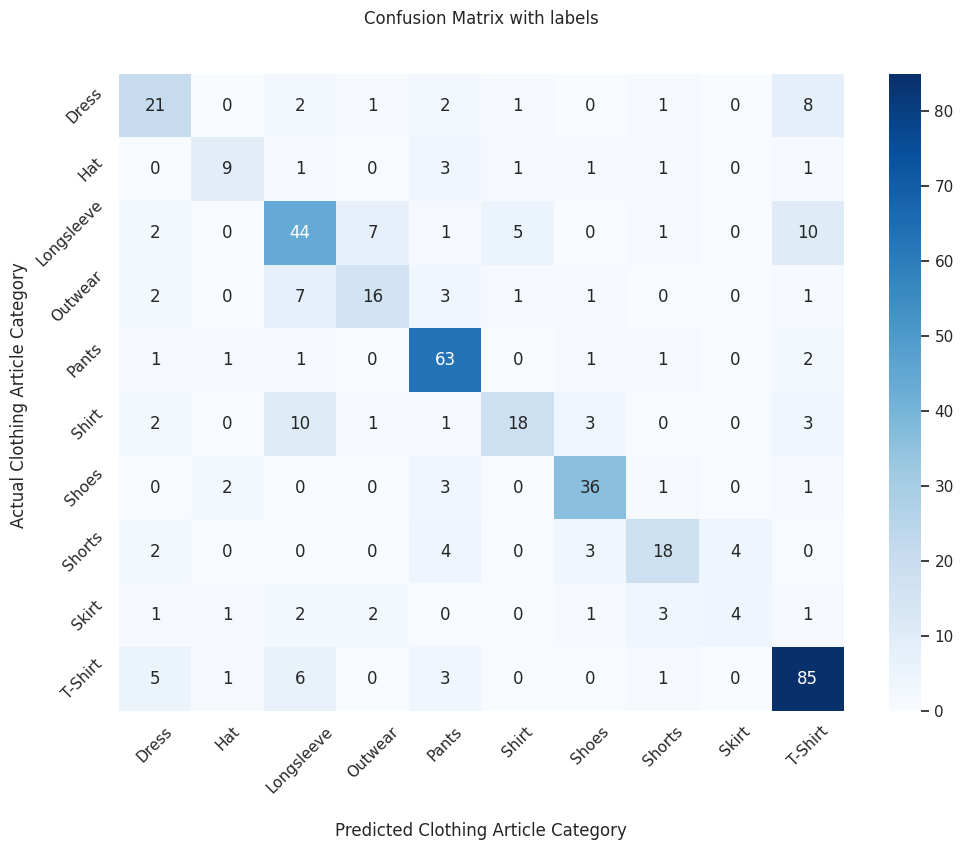

In [ ]:
confusionMatrix = confusion_matrix(np.argmax(y_test_true, axis=1), np.argmax(y_pred, axis=1))

ax = sns.heatmap(confusionMatrix, annot=True, cmap='Blues',fmt='g')

ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Clothing Article Category')
ax.set_ylabel('Actual Clothing Article Category ');

## Ticket labels - List must be in alphabetical order
ax.xaxis.set_ticklabels(list(test_generator_top10.class_indices.keys()), rotation=45)
ax.yaxis.set_ticklabels(list(test_generator_top10.class_indices.keys()), rotation=45)

## Display the visualization of the Confusion Matrix.
plt.show()

#### Classification Report

In [ ]:
print(classification_report(np.argmax(y_test_true, axis=1), np.argmax(y_pred, axis=1),target_names=list(test_generator_top10.class_indices.keys()), zero_division=0))

              precision    recall  f1-score   support

       Dress       0.58      0.58      0.58        36
         Hat       0.64      0.53      0.58        17
  Longsleeve       0.60      0.63      0.62        70
     Outwear       0.59      0.52      0.55        31
       Pants       0.76      0.90      0.82        70
       Shirt       0.69      0.47      0.56        38
       Shoes       0.78      0.84      0.81        43
      Shorts       0.67      0.58      0.62        31
       Skirt       0.50      0.27      0.35        15
     T-Shirt       0.76      0.84      0.80       101

    accuracy                           0.69       452
   macro avg       0.66      0.62      0.63       452
weighted avg       0.69      0.69      0.69       452



### ***Display Images from the Test Dataset***

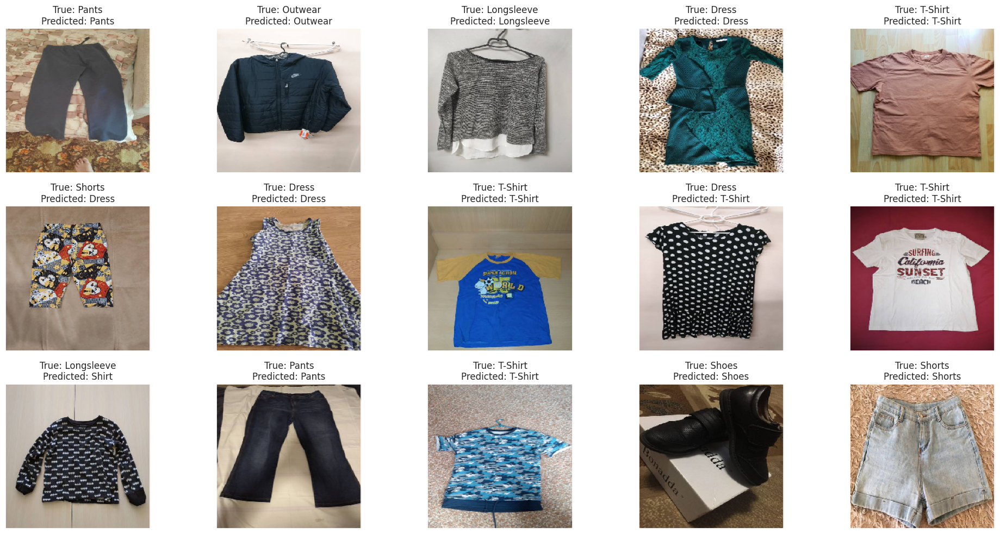

In [ ]:
# Display 15 picture of the dataset with their labels
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(20, 10),
                        subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
  ax.imshow(X_test_[i])
  ax.set_title(f"True: {list(test_generator_top10.class_indices.keys())[list(test_generator_top10.class_indices.values()).index(np.argmax(y_test_true, axis=1)[i])]}\nPredicted: {list(test_generator_top10.class_indices.keys())[list(test_generator_top10.class_indices.values()).index(np.argmax(y_pred, axis=1)[i])]}")
plt.tight_layout()
plt.show();



---



---



---



## <a>**Approach 4 `ConvNext Pretrained Model`**

### ***CNN Model Network***

In [ ]:
# Model
MODEL_PATH = "https://tfhub.dev/sayakpaul/convnext_tiny_1k_224_fe/1" 
model_name="Clothing_Articles_ConvNext_Model"
inputs = tf.keras.Input((224, 224, 3))
hub_module = hub.KerasLayer(MODEL_PATH, trainable=True)
X = hub_module(inputs, training=False) 

# Density Prediction
dens = Dense(units=256, activation='relu')(X)
dens = BatchNormalization()(dens)
dens = Dropout(0.2)(dens)
dens = Dense(units=128, activation='relu')(dens)
dens = BatchNormalization()(dens)
dens = Dropout(0.2)(dens)
outputs  = Dense(units=17, activation='softmax')(dens)


model_conv = tf.keras.Model(inputs, [outputs])
model_conv.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 keras_layer (KerasLayer)    (None, 768)               27820128  
                                                                 
 dense (Dense)               (None, 256)               196864    
                                                                 
 batch_normalization (BatchN  (None, 256)              1024      
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 128)               32896     
                                                             

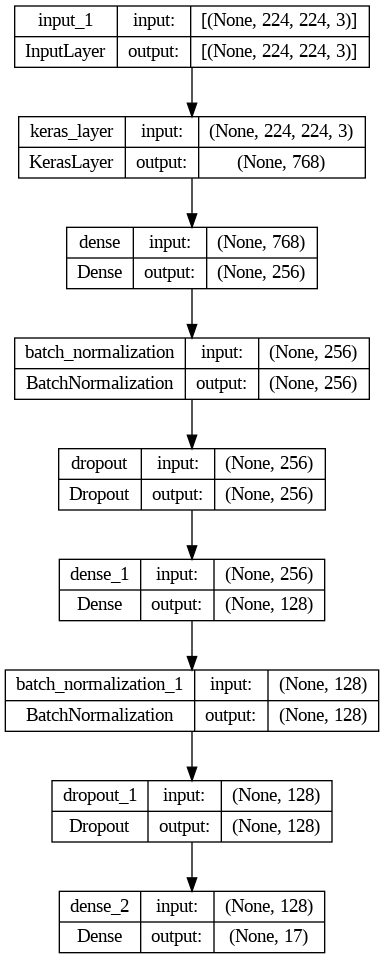

In [ ]:
plot_model(model_conv, to_file='convNext_model_plot2.png', show_shapes=True, show_layer_names=True) 

### ***CNN Training***

In [ ]:
optimizer = Adam(learning_rate=0.0001)
model_conv.compile(loss='categorical_crossentropy',optimizer=optimizer,metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', patience=10,verbose=1,factor=0.2)
checkpoint = ModelCheckpoint('models/'+model_name+'.h5', monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
early_stop = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=20)

In [ ]:
epochs = 50
batch_size = 64
history = model_conv.fit(train_generator,steps_per_epoch= train_steps,epochs=epochs,validation_data=val_generator,
                    validation_steps=validation_steps,verbose = 1,callbacks=[reduce_lr, early_stop])

Epoch 1/50
63/63 [==============================] - 20s 309ms/step - loss: 0.6201 - accuracy: 0.8213 - val_loss: 1.6934 - val_accuracy: 0.7522 - lr: 1.0000e-04
Epoch 2/50
63/63 [==============================] - 20s 309ms/step - loss: 0.4080 - accuracy: 0.8883 - val_loss: 1.3068 - val_accuracy: 0.8237 - lr: 1.0000e-04
Epoch 3/50
63/63 [==============================] - 20s 309ms/step - loss: 0.2757 - accuracy: 0.9240 - val_loss: 0.8752 - val_accuracy: 0.8527 - lr: 1.0000e-04
Epoch 4/50
63/63 [==============================] - 20s 308ms/step - loss: 0.1771 - accuracy: 0.9571 - val_loss: 0.6826 - val_accuracy: 0.8326 - lr: 1.0000e-04
Epoch 5/50
63/63 [==============================] - 20s 308ms/step - loss: 0.1234 - accuracy: 0.9708 - val_loss: 0.5216 - val_accuracy: 0.8504 - lr: 1.0000e-04
Epoch 6/50
63/63 [==============================] - 20s 307ms/step - loss: 0.0867 - accuracy: 0.9840 - val_loss: 0.4826 - val_accuracy: 0.8661 - lr: 1.0000e-04
Epoch 7/50
63/63 [======================

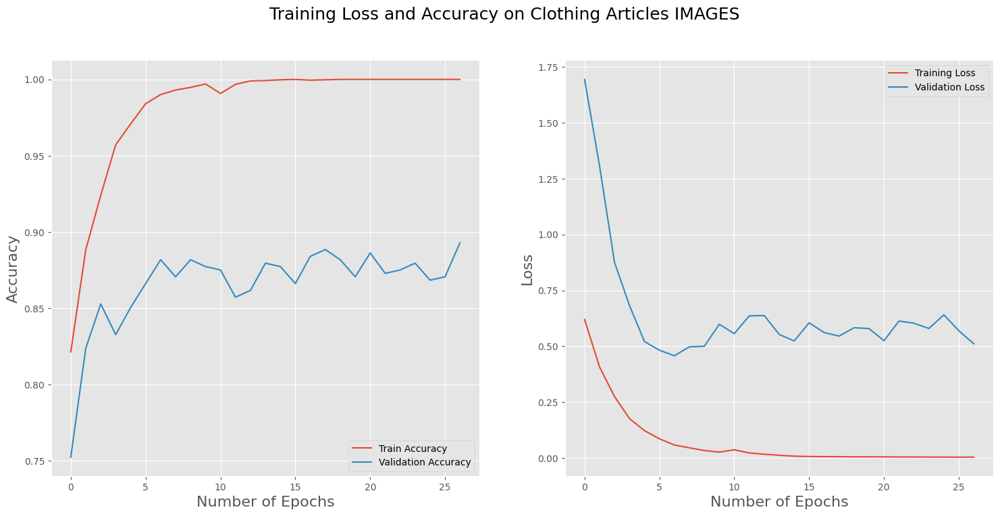

In [ ]:
plt.figure(figsize=(18,8))
plt.style.use("ggplot")
title = "Training Loss and Accuracy on Clothing Articles IMAGES "
plt.suptitle(title, fontsize=18)
plt.subplot(1,2,1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.xlabel('Number of Epochs', fontsize=16)
plt.ylabel('Accuracy', fontsize=16)

plt.subplot(1,2,2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.legend()
plt.xlabel('Number of Epochs', fontsize=16)
plt.ylabel('Loss', fontsize=16)


plt.show()

### **Evaluation on Test**

In [ ]:
valid_loss, valid_accuracy = model_conv.evaluate(val_generator)
test_loss, test_accuracy   = model_conv.evaluate(test_generator)
                           

print('Validation Accuracy: ', round((valid_accuracy * 100), 1), "%")
print('Test Accuracy: ', round((test_accuracy * 100), 1), "%")
print(" ")
print('Validation Loss: ', round(valid_loss, 1))
print('Test Loss: ', round(test_loss, 1))

8/8 [==============================] - 2s 262ms/step - loss: 0.4339 - accuracy: 0.9000
Validation Accuracy:  87.6 %
Test Accuracy:  90.0 %
 
Validation Loss:  0.6
Test Loss:  0.4


### **Save Keras Model to Drive**

In [ ]:
model_conv.save('models/'+model_name)

In [ ]:
%cp -r /content/models/Clothing_Articles_ConvNext_Model /content/drive/MyDrive/Tahaluf_ML_Task

### ***`Confusion Matrix` and `Classification Report`***

#### Iterating over the test batches to Store the Data in `X_test_`, `y_test_true`

In [ ]:
test_generator.reset()
X_test_, y_test_true = [],[] 
for i in range(test_steps+1):
    X , y = next(test_generator)
    X_test_.extend(X) 
    y_test_true.extend(y)

In [ ]:
X_test_    = np.array(X_test_)
y_test_true= np.array(y_test_true)
print(X_test_.shape, y_test_true.shape)

(510, 224, 224, 3) (510, 17)


#### Predict on `X_test_`

In [ ]:
y_pred = model_conv.predict(X_test_)

16/16 [==============================] - 2s 54ms/step


#### Confusion Matrix

In [ ]:
list(test_generator.class_indices.keys())

['Blazer',
 'Blouse',
 'Body',
 'Dress',
 'Hat',
 'Hoodie',
 'Longsleeve',
 'Outwear',
 'Pants',
 'Polo',
 'Shirt',
 'Shoes',
 'Shorts',
 'Skirt',
 'T-Shirt',
 'Top',
 'Undershirt']

In [ ]:
sns.set(rc={'figure.figsize':(11.7,8.27)})

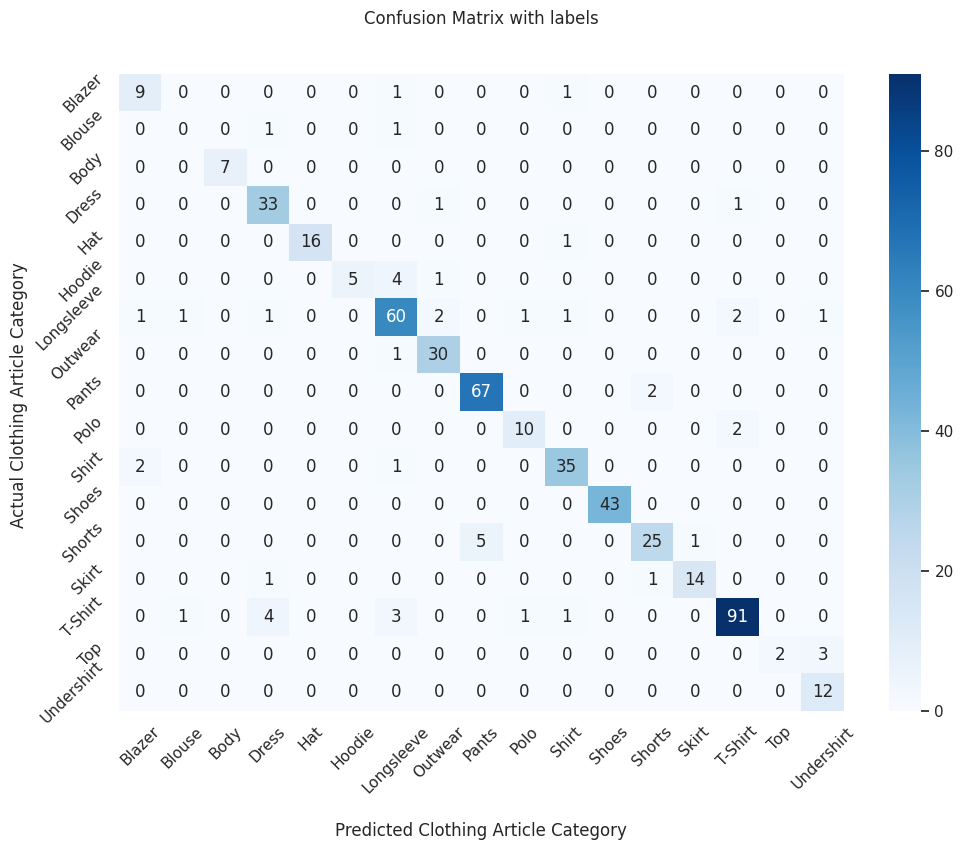

In [ ]:
confusionMatrix = confusion_matrix(np.argmax(y_test_true, axis=1), np.argmax(y_pred, axis=1))

ax = sns.heatmap(confusionMatrix, annot=True, cmap='Blues',fmt='g')

ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Clothing Article Category')
ax.set_ylabel('Actual Clothing Article Category ');

## Ticket labels - List must be in alphabetical order
ax.xaxis.set_ticklabels(list(test_generator.class_indices.keys()), rotation=45)
ax.yaxis.set_ticklabels(list(test_generator.class_indices.keys()), rotation=45)

## Display the visualization of the Confusion Matrix.
plt.show()

#### Classification Report

In [ ]:
print(classification_report(np.argmax(y_test_true, axis=1), np.argmax(y_pred, axis=1),target_names=list(test_generator.class_indices.keys()), zero_division=0))

              precision    recall  f1-score   support

      Blazer       0.75      0.82      0.78        11
      Blouse       0.00      0.00      0.00         2
        Body       1.00      1.00      1.00         7
       Dress       0.82      0.94      0.88        35
         Hat       1.00      0.94      0.97        17
      Hoodie       1.00      0.50      0.67        10
  Longsleeve       0.85      0.86      0.85        70
     Outwear       0.88      0.97      0.92        31
       Pants       0.93      0.97      0.95        69
        Polo       0.83      0.83      0.83        12
       Shirt       0.90      0.92      0.91        38
       Shoes       1.00      1.00      1.00        43
      Shorts       0.89      0.81      0.85        31
       Skirt       0.93      0.88      0.90        16
     T-Shirt       0.95      0.90      0.92       101
         Top       1.00      0.40      0.57         5
  Undershirt       0.75      1.00      0.86        12

    accuracy              

### ***Display Images from the Test Dataset***

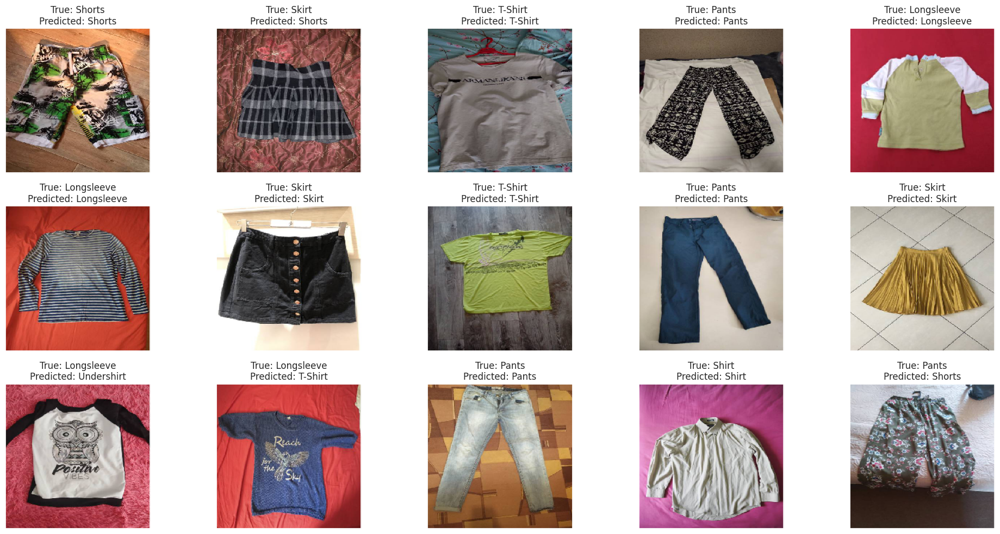

In [ ]:
# Display 15 picture of the dataset with their labels
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(20, 10),
                        subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
  ax.imshow(X_test_[i])
  ax.set_title(f"True: {list(test_generator.class_indices.keys())[list(test_generator.class_indices.values()).index(np.argmax(y_test_true, axis=1)[i])]}\nPredicted: {list(test_generator.class_indices.keys())[list(test_generator.class_indices.values()).index(np.argmax(y_pred, axis=1)[i])]}")
plt.tight_layout()
plt.show();



---



---



---



## <a>**Check `ConvNext Pretrained Model` With Kfold Cross-Validation**

In [ ]:
def get_x_y_from_generators(datagen):
    datagen.reset()
    X_, y_ = [],[] 
    steps_= datagen.n // datagen.batch_size
    for i in range(steps_+1):
        X , y = next(datagen)
        X_.extend(X) 
        y_.extend(y)
    X_= np.array(X_)
    y_= np.array(y_)
    return X_, y_

In [ ]:
def visualization_loss_acc(history):
  plt.figure(figsize=(18,8))
  plt.style.use("ggplot")
  title = "Training Loss and Accuracy on Clothing Articles IMAGES "
  plt.suptitle(title, fontsize=18)
  plt.subplot(1,2,1)
  plt.plot(history.history['accuracy'], label='Train Accuracy')
  plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
  plt.legend()
  plt.xlabel('Number of Epochs', fontsize=16)
  plt.ylabel('Accuracy', fontsize=16)

  plt.subplot(1,2,2)
  plt.plot(history.history['loss'], label='Training Loss')
  plt.plot(history.history['val_loss'], label='Validation Loss')
  plt.legend()
  plt.xlabel('Number of Epochs', fontsize=16)
  plt.ylabel('Loss', fontsize=16)
  plt.show()

In [ ]:
def plot_confusion_matrix_(y_test_true, y_pred ,classes):
    sns.set(rc={'figure.figsize':(11.7,8.27)})
    confusionMatrix = confusion_matrix(np.argmax(y_test_true, axis=1), np.argmax(y_pred, axis=1))

    ax = sns.heatmap(confusionMatrix, annot=True, cmap='Blues',fmt='g')

    ax.set_title('Confusion Matrix with labels\n\n');
    ax.set_xlabel('\nPredicted Clothing Article Category')
    ax.set_ylabel('Actual Clothing Article Category ');

    ## Ticket labels - List must be in alphabetical order
    ax.xaxis.set_ticklabels(classes, rotation=45)
    ax.yaxis.set_ticklabels(classes, rotation=45)

    ## Display the visualization of the Confusion Matrix.
    plt.show()

In [ ]:
# Model
def convNextModel(clsNum):
  MODEL_PATH = "https://tfhub.dev/sayakpaul/convnext_tiny_1k_224_fe/1" 
  model_name="Clothing_Articles_ConvNext_Model"
  inputs = tf.keras.Input((224, 224, 3))
  hub_module = hub.KerasLayer(MODEL_PATH, trainable=True)
  X = hub_module(inputs, training=False) 

  # Density Prediction
  dens = Dense(units=256, activation='relu')(X)
  dens = BatchNormalization()(dens)
  dens = Dropout(0.2)(dens)
  dens = Dense(units=128, activation='relu')(dens)
  dens = BatchNormalization()(dens)
  dens = Dropout(0.2)(dens)
  outputs  = Dense(units=clsNum, activation='softmax')(dens)


  model_conv = tf.keras.Model(inputs, [outputs])
  optimizer = Adam(learning_rate=0.0001)
  model_conv.compile(loss='categorical_crossentropy',optimizer=optimizer,metrics=['accuracy'])
  return model_conv

In [ ]:
# Define the KFold cross-validation setup and parameters:
num_folds = 5
kf = KFold(n_splits=num_folds, shuffle=True, random_state=42)

**************************************************************************************************
Training for fold 1 ...
**************************************************************************************************
Found 4076 validated image filenames belonging to 17 classes.
Found 1020 validated image filenames belonging to 17 classes.
Epoch 1/20
63/63 [==============================] - 91s 562ms/step - loss: 1.6733 - accuracy: 0.5354 - val_loss: 2.1536 - val_accuracy: 0.7083
Epoch 2/20
63/63 [==============================] - 33s 521ms/step - loss: 0.6273 - accuracy: 0.8205 - val_loss: 1.6558 - val_accuracy: 0.7969
Epoch 3/20
63/63 [==============================] - 33s 517ms/step - loss: 0.4132 - accuracy: 0.8881 - val_loss: 1.2837 - val_accuracy: 0.8052
Epoch 4/20
63/63 [==============================] - 33s 517ms/step - loss: 0.2757 - accuracy: 0.9292 - val_loss: 0.8480 - val_accuracy: 0.8562
Epoch 5/20
63/63 [==============================] - 33s 521ms/step - loss: 0.1869 

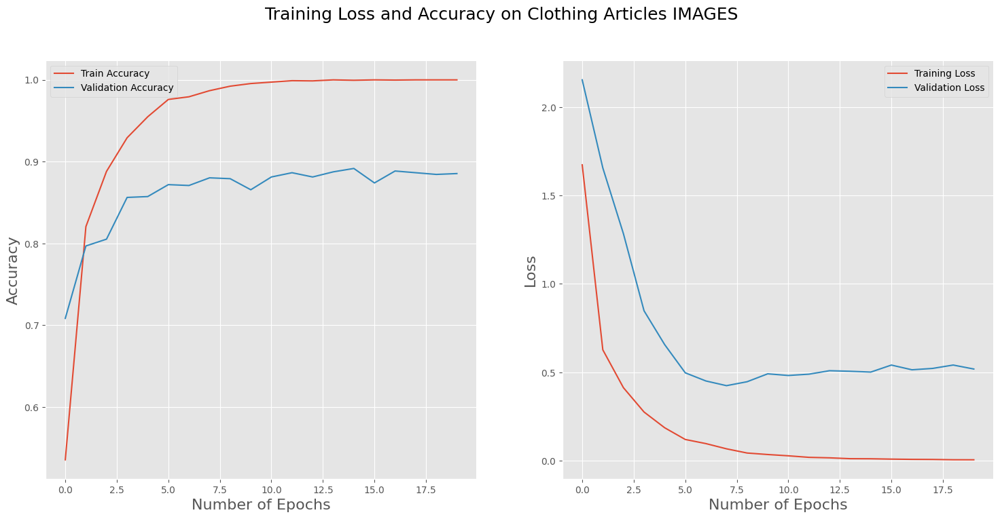

16/16 [==============================] - 5s 326ms/step - loss: 0.5244 - accuracy: 0.8853
Fold 1: Loss = 0.5244311094284058, Accuracy = 0.8852941393852234
32/32 [==============================] - 4s 94ms/step


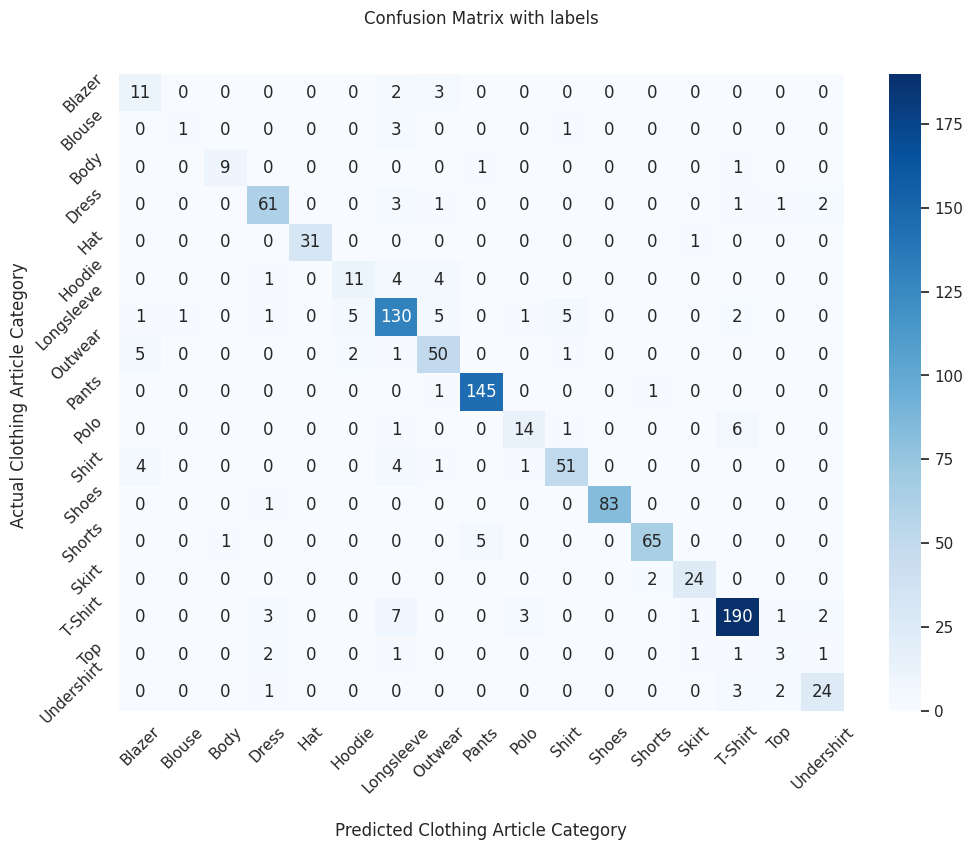

F1 SCORE Weighted: 0.8843235055088843
              precision    recall  f1-score   support

      Blazer       0.52      0.69      0.59        16
      Blouse       0.50      0.20      0.29         5
        Body       0.90      0.82      0.86        11
       Dress       0.87      0.88      0.88        69
         Hat       1.00      0.97      0.98        32
      Hoodie       0.61      0.55      0.58        20
  Longsleeve       0.83      0.86      0.85       151
     Outwear       0.77      0.85      0.81        59
       Pants       0.96      0.99      0.97       147
        Polo       0.74      0.64      0.68        22
       Shirt       0.86      0.84      0.85        61
       Shoes       1.00      0.99      0.99        84
      Shorts       0.96      0.92      0.94        71
       Skirt       0.89      0.92      0.91        26
     T-Shirt       0.93      0.92      0.92       207
         Top       0.43      0.33      0.38         9
  Undershirt       0.83      0.80      0.81

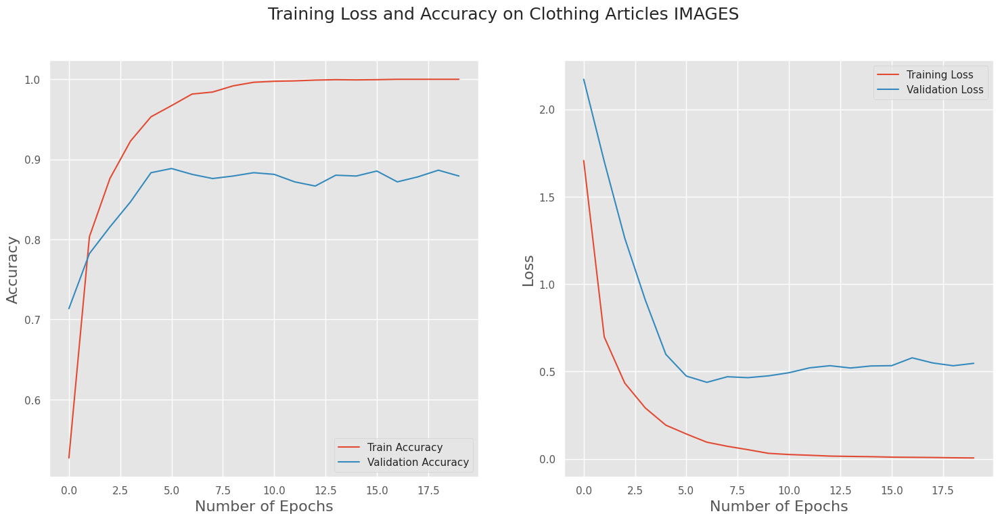

16/16 [==============================] - 5s 324ms/step - loss: 0.5227 - accuracy: 0.8832
Fold 2: Loss = 0.5227455496788025, Accuracy = 0.8832188248634338
32/32 [==============================] - 4s 95ms/step


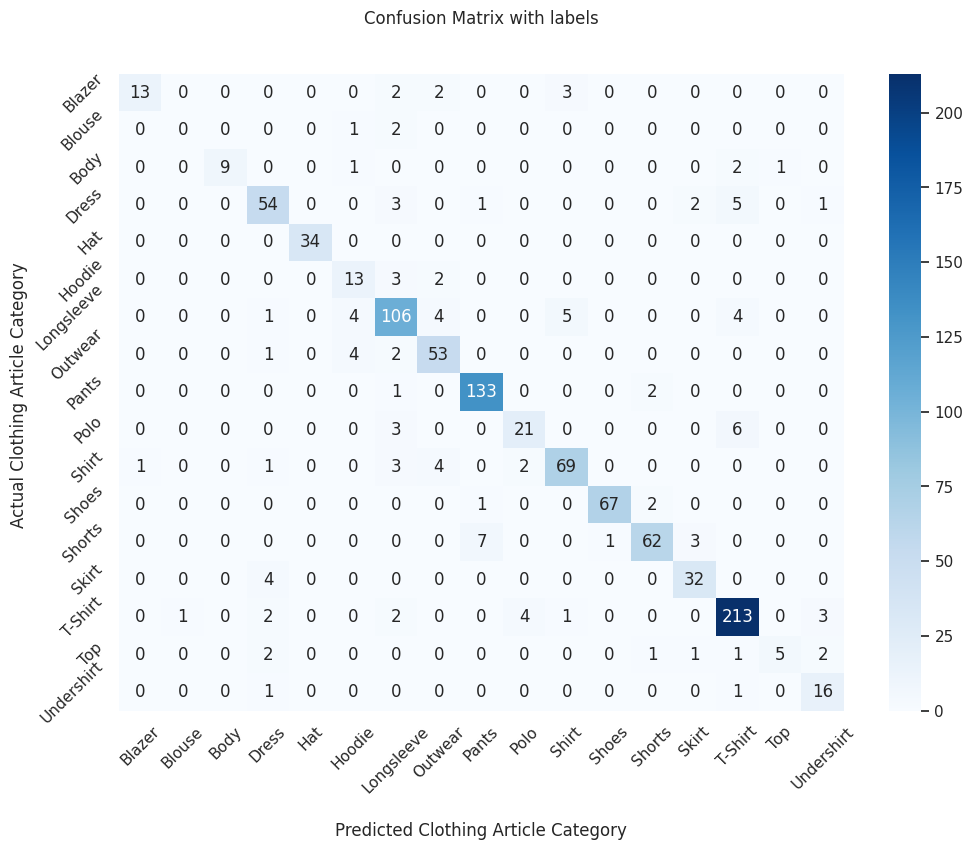

F1 SCORE Weighted: 0.8813600849653943
              precision    recall  f1-score   support

      Blazer       0.93      0.65      0.76        20
      Blouse       0.00      0.00      0.00         3
        Body       1.00      0.69      0.82        13
       Dress       0.82      0.82      0.82        66
         Hat       1.00      1.00      1.00        34
      Hoodie       0.57      0.72      0.63        18
  Longsleeve       0.83      0.85      0.84       124
     Outwear       0.82      0.88      0.85        60
       Pants       0.94      0.98      0.96       136
        Polo       0.78      0.70      0.74        30
       Shirt       0.88      0.86      0.87        80
       Shoes       0.99      0.96      0.97        70
      Shorts       0.93      0.85      0.89        73
       Skirt       0.84      0.89      0.86        36
     T-Shirt       0.92      0.94      0.93       226
         Top       0.83      0.42      0.56        12
  Undershirt       0.73      0.89      0.80

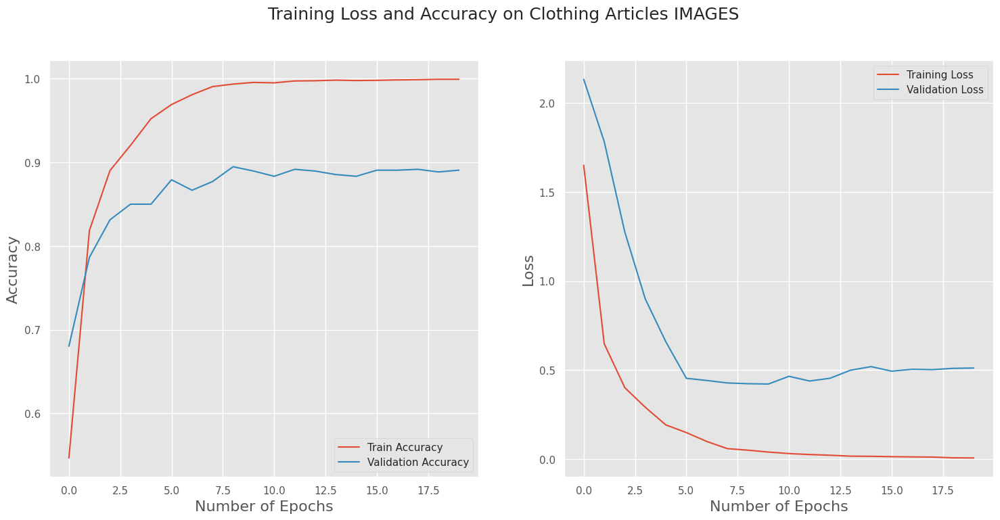

16/16 [==============================] - 5s 299ms/step - loss: 0.4873 - accuracy: 0.8950
Fold 3: Loss = 0.48730728030204773, Accuracy = 0.8949950933456421
32/32 [==============================] - 4s 87ms/step


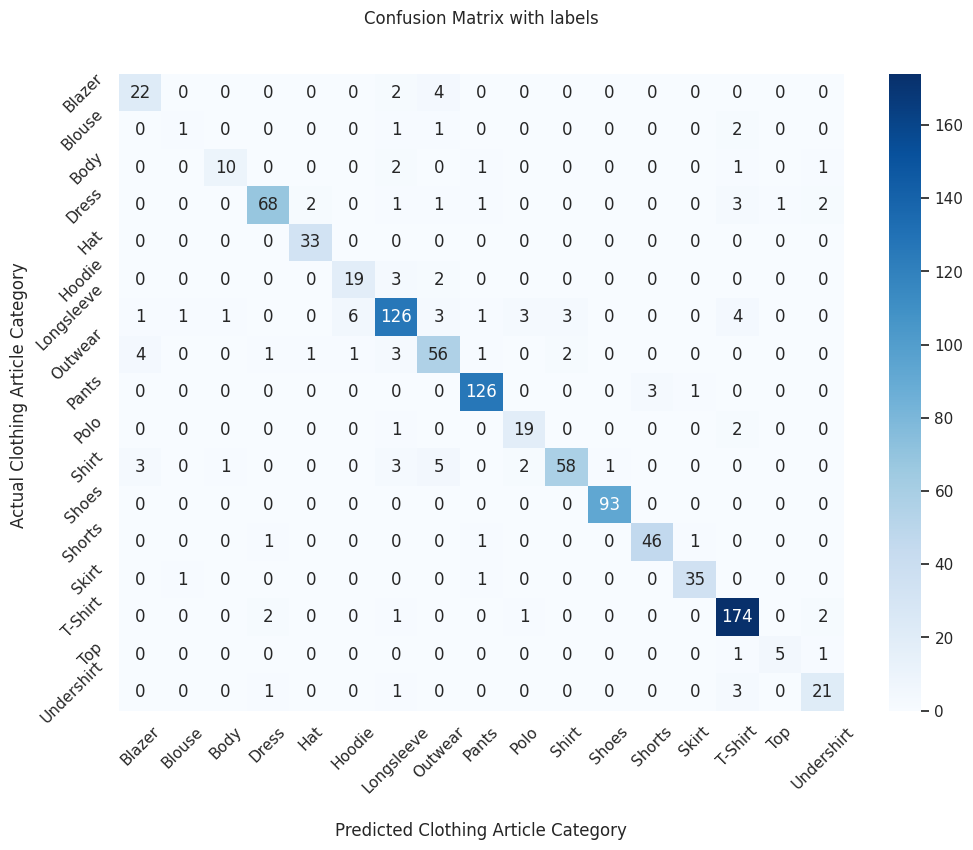

F1 SCORE Weighted: 0.8939441291003781
              precision    recall  f1-score   support

      Blazer       0.73      0.79      0.76        28
      Blouse       0.33      0.20      0.25         5
        Body       0.83      0.67      0.74        15
       Dress       0.93      0.86      0.89        79
         Hat       0.92      1.00      0.96        33
      Hoodie       0.73      0.79      0.76        24
  Longsleeve       0.88      0.85      0.86       149
     Outwear       0.78      0.81      0.79        69
       Pants       0.95      0.97      0.96       130
        Polo       0.76      0.86      0.81        22
       Shirt       0.92      0.79      0.85        73
       Shoes       0.99      1.00      0.99        93
      Shorts       0.94      0.94      0.94        49
       Skirt       0.95      0.95      0.95        37
     T-Shirt       0.92      0.97      0.94       180
         Top       0.83      0.71      0.77         7
  Undershirt       0.78      0.81      0.79

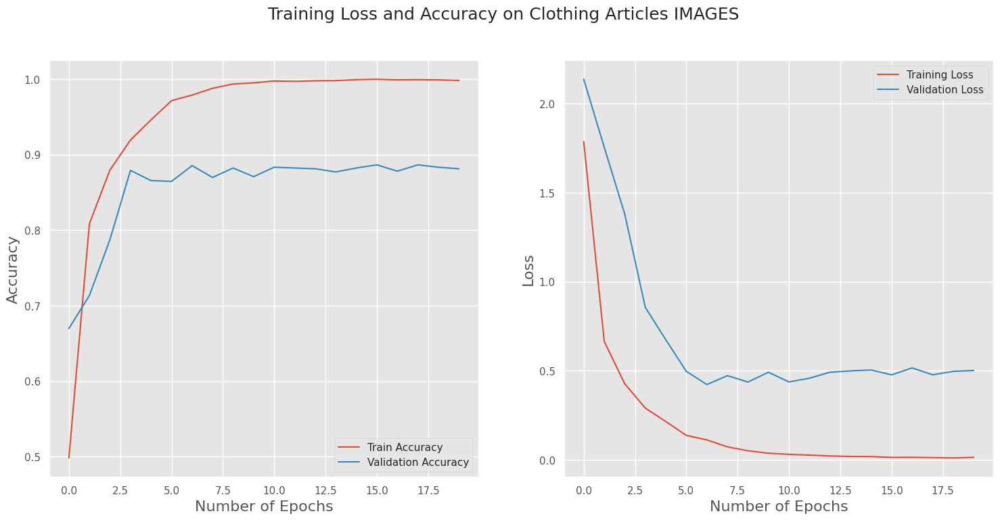

16/16 [==============================] - 5s 286ms/step - loss: 0.4761 - accuracy: 0.8871
Fold 4: Loss = 0.47605445981025696, Accuracy = 0.8871442675590515
32/32 [==============================] - 4s 86ms/step


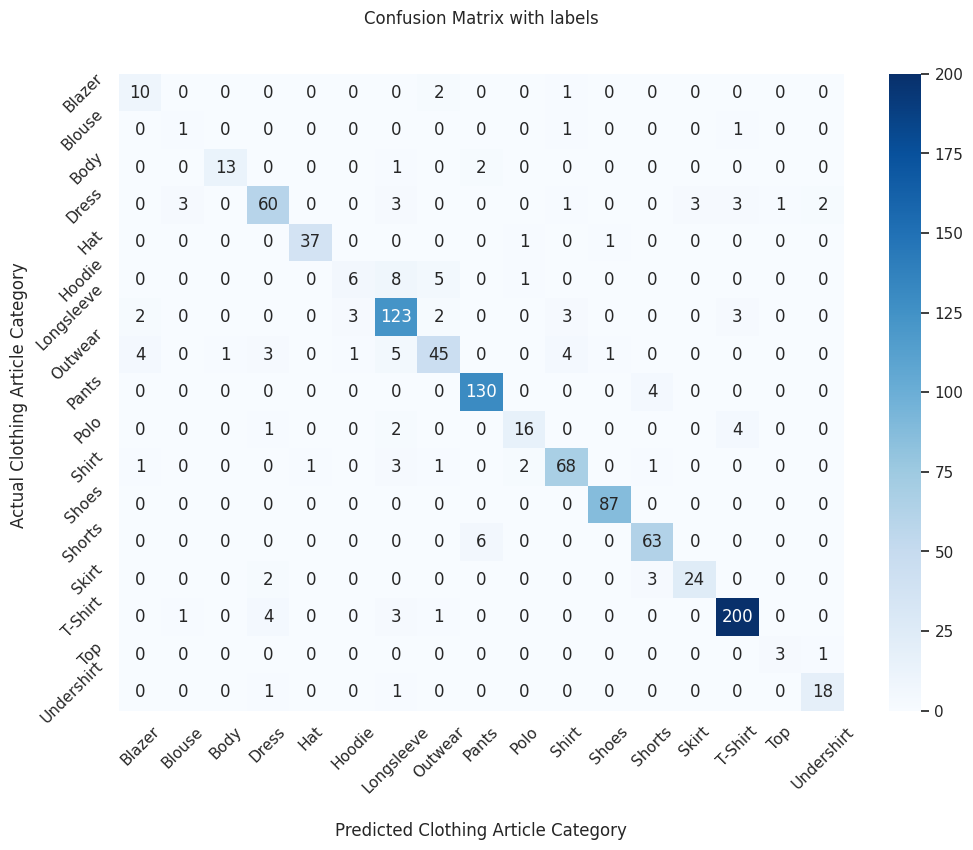

F1 SCORE Weighted: 0.8847272312678521
              precision    recall  f1-score   support

      Blazer       0.59      0.77      0.67        13
      Blouse       0.20      0.33      0.25         3
        Body       0.93      0.81      0.87        16
       Dress       0.85      0.79      0.82        76
         Hat       0.97      0.95      0.96        39
      Hoodie       0.60      0.30      0.40        20
  Longsleeve       0.83      0.90      0.86       136
     Outwear       0.80      0.70      0.75        64
       Pants       0.94      0.97      0.96       134
        Polo       0.80      0.70      0.74        23
       Shirt       0.87      0.88      0.88        77
       Shoes       0.98      1.00      0.99        87
      Shorts       0.89      0.91      0.90        69
       Skirt       0.89      0.83      0.86        29
     T-Shirt       0.95      0.96      0.95       209
         Top       0.75      0.75      0.75         4
  Undershirt       0.86      0.90      0.88

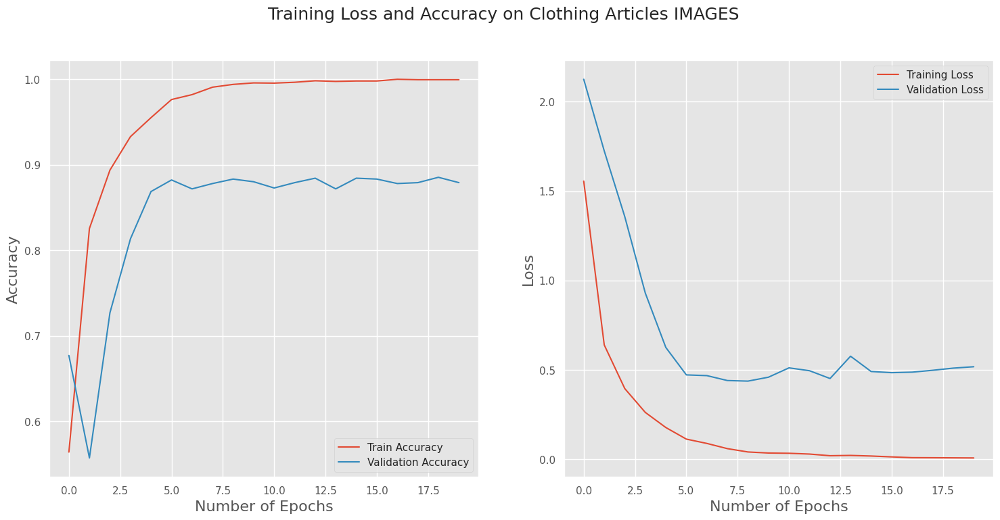

16/16 [==============================] - 5s 291ms/step - loss: 0.4945 - accuracy: 0.8842
Fold 5: Loss = 0.4944525957107544, Accuracy = 0.8842002153396606
32/32 [==============================] - 4s 89ms/step


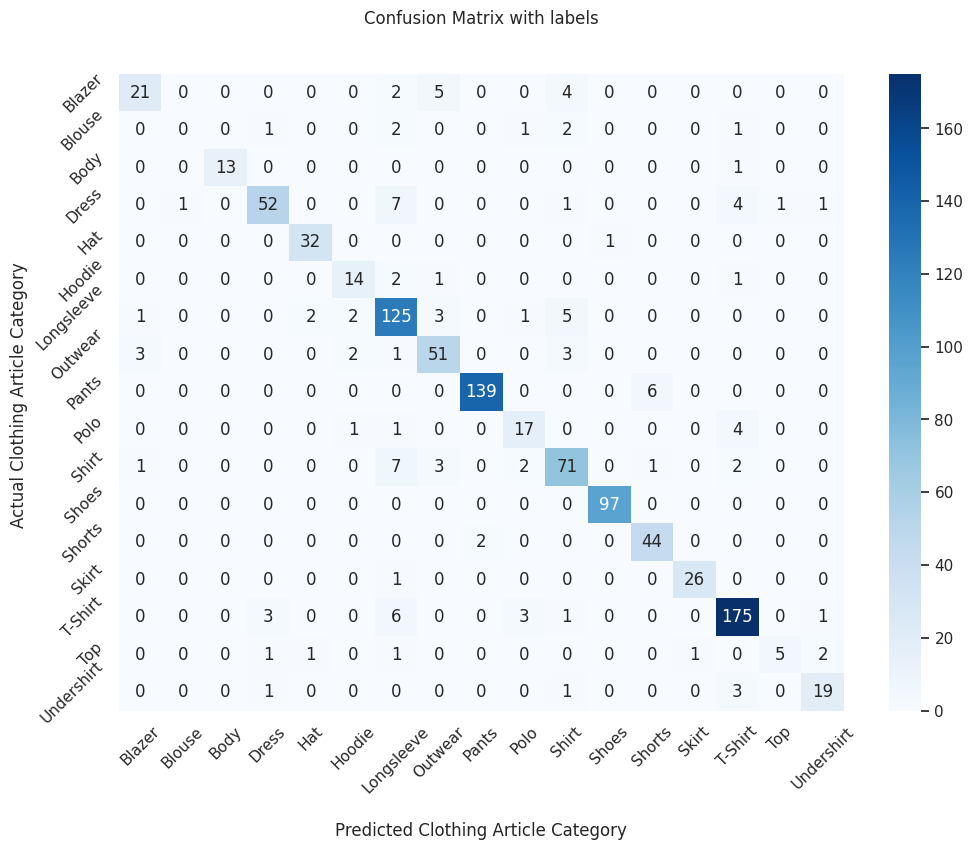

F1 SCORE Weighted: 0.8806640532062369
              precision    recall  f1-score   support

      Blazer       0.81      0.66      0.72        32
      Blouse       0.00      0.00      0.00         7
        Body       1.00      0.93      0.96        14
       Dress       0.90      0.78      0.83        67
         Hat       0.91      0.97      0.94        33
      Hoodie       0.74      0.78      0.76        18
  Longsleeve       0.81      0.90      0.85       139
     Outwear       0.81      0.85      0.83        60
       Pants       0.99      0.96      0.97       145
        Polo       0.71      0.74      0.72        23
       Shirt       0.81      0.82      0.81        87
       Shoes       0.99      1.00      0.99        97
      Shorts       0.86      0.96      0.91        46
       Skirt       0.96      0.96      0.96        27
     T-Shirt       0.92      0.93      0.92       189
         Top       0.83      0.45      0.59        11
  Undershirt       0.83      0.79      0.81

In [ ]:
## Loop through the folds and train the model:
epochs= 20
fold_number = 1
kFold_scoresDict={}
for train_index, test_index in kf.split(dfImages_v2):
    print('==================================================================================================')
    print("**************************************************************************************************")
    print(f'Training for fold {fold_number} ...')
    print("**************************************************************************************************")
    print('==================================================================================================')
    train_data = dfImages_v2.iloc[train_index]
    test_data = dfImages_v2.iloc[test_index]

    train_generator_fold = train_datagen.flow_from_dataframe(dataframe= train_data, x_col='image', y_col='label', target_size=(224, 224), batch_size=64, class_mode='categorical', shuffle=True)
    test_generator_fold = val_datagen.flow_from_dataframe(dataframe= test_data,x_col='image', y_col='label', target_size=(224, 224), batch_size=64, class_mode='categorical', shuffle=False)
    train_stepSize = train_generator_fold.n//train_generator_fold.batch_size
    test_stepSize = test_generator_fold.n//test_generator_fold.batch_size

    model = convNextModel(17)
    h = model.fit(train_generator_fold, steps_per_epoch=train_stepSize, validation_data=test_generator_fold, 
                  validation_steps=test_stepSize, epochs=epochs, verbose=1)
    visualization_loss_acc(h)

    # Evaluate the model on the test set
    loss, accuracy = model.evaluate(test_generator_fold, verbose=1)
    
    print(f"Fold {fold_number}: Loss = {loss}, Accuracy = {accuracy}")
    X_test, y_test = get_x_y_from_generators(test_generator_fold)
    y_pred = model.predict(X_test)
    plot_confusion_matrix_(y_test, y_pred, classes)
    f_1 = f1_score(np.argmax(y_test, axis=1),np.argmax(y_pred, axis=1),average='weighted')
    print('F1 SCORE Weighted:', f_1)
    print(classification_report(np.argmax(y_test, axis=1), np.argmax(y_pred, axis=1),target_names=classes, zero_division=0))
    kFold_scoresDict['Fold'+str(fold_number)]={'f1Score':f_1, 'Accuracy':accuracy, "Loss": loss}
    fold_number += 1
    gc.collect()


In [ ]:
kFold_scoresDict

{'Fold1': {'f1Score': 0.8843235055088843,
  'Accuracy': 0.8852941393852234,
  'Loss': 0.5244311094284058},
 'Fold2': {'f1Score': 0.8813600849653943,
  'Accuracy': 0.8832188248634338,
  'Loss': 0.5227455496788025},
 'Fold3': {'f1Score': 0.8939441291003781,
  'Accuracy': 0.8949950933456421,
  'Loss': 0.48730728030204773},
 'Fold4': {'f1Score': 0.8847272312678521,
  'Accuracy': 0.8871442675590515,
  'Loss': 0.47605445981025696},
 'Fold5': {'f1Score': 0.8806640532062369,
  'Accuracy': 0.8842002153396606,
  'Loss': 0.4944525957107544}}

In [ ]:
sum([d['Accuracy'] for d in kFold_scoresDict.values()])/5

0.8869705080986023

In [ ]:
sum([d['f1Score'] for d in kFold_scoresDict.values()])/5

0.8850038008097492

In [ ]:
sum([d['Loss'] for d in kFold_scoresDict.values()])/5

0.5009981989860535



---



---



---



## <a>**Calclating Number of Flops and MACCS**

In [ ]:
import tensorflow as tf
import numpy as np
import keras
import time
from tensorflow.python.profiler import model_analyzer
from tensorflow.python.profiler import option_builder
from keras.models import load_model
from tensorflow.keras.utils import plot_model

In [ ]:
import matplotlib
get_ipython().run_line_magic('matplotlib', 'inline')
matplotlib.rc('figure', figsize = (20, 8))
matplotlib.rc('font', size = 14)
matplotlib.rc('axes.spines', top = False, right = False)
matplotlib.rc('axes', grid = False)
matplotlib.rc('axes', facecolor = 'white')

In [ ]:
!git clone https://github.com/ckyrkou/Keras_FLOP_Estimator.git

Cloning into 'Keras_FLOP_Estimator'...
remote: Enumerating objects: 176, done.
remote: Counting objects: 100% (11/11), done.
remote: Compressing objects: 100% (11/11), done.
remote: Total 176 (delta 3), reused 0 (delta 0), pack-reused 165
Receiving objects: 100% (176/176), 140.48 KiB | 14.05 MiB/s, done.
Resolving deltas: 100% (82/82), done.


In [ ]:
from Keras_FLOP_Estimator.python_code.net_flops import net_flops

**Keras Model Timing Performance Per Layer**
- This is a function for estimating the timing performance of each leayer in a neural network. It can be used to identify the bottlenecks in computation when run on the target device. The function iterates over the network by runninng an input image through it by removing each of the layers. The layer time is found by subtracting the current run without the last layer from the previous run that contained the layer. There are some timing issues where the timings are off a bit thus some times may appear as negative. In such, case the layer compute time can be considered as negligible.



In [ ]:
def time_per_layer(model):
    new_model = model

    times = np.zeros((len(model.layers), 2))
    inp = np.ones((224, 224, 3))

    for i in range(1, len(model.layers)):
        new_model = keras.models.Model(inputs=[model.input], outputs=[model.layers[-i].output])

        # new_model.summary()
        new_model.predict(inp[None, :, :, :], verbose=0)

        t_s = time.time()
        new_model.predict(inp[None, :, :, :], verbose=0)
        t_e2 = time.time() - t_s

        times[i, 1] = t_e2
        del new_model

    for i in range(0, len(model.layers) - 1):
        times[i, 0] = abs(times[i + 1, 1] - times[i, 1])

    times[-1, 0] = times[-1, 1]


    return times

#### **Calculations for Approach1**

In [ ]:
scratch_model = load_model("/content/drive/MyDrive/Tahaluf_ML_Task/Clothing_Articles_Model.h5")

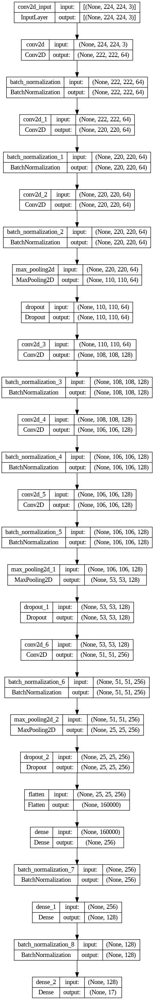

In [ ]:
plot_model(scratch_model, show_shapes=True, show_layer_names=True) 

In [ ]:
net_flops(scratch_model,table=True)

               Layer Name |      Input Shape |     Output Shape |      Kernel Size |          Filters | Strides |  FLOPS
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                   conv2d |    [224, 224, 3] |   [222, 222, 64] |           (3, 3) |               64 | (1, 1) | 173408256.0000
      batch_normalization |   [222, 222, 64] |   [222, 222, 64] |           [0, 0] |           [0, 0] | [1, 1] | 0.0000
                 conv2d_1 |   [222, 222, 64] |   [220, 220, 64] |           (3, 3) |               64 | (1, 1) | 3633610752.0000
    batch_normalization_1 |   [220, 220, 64] |   [220, 220, 64] |           [0, 0] |           [0, 0] | [1, 1] | 0.0000
                 conv2d_2 |   [220, 220, 64] |   [220, 220, 64] |           (5, 5) |               64 | (1, 1) | 9912320000.0000
    batch_normalization_2 |   [220, 220, 64] |   [220, 220, 64] |           [0, 0]

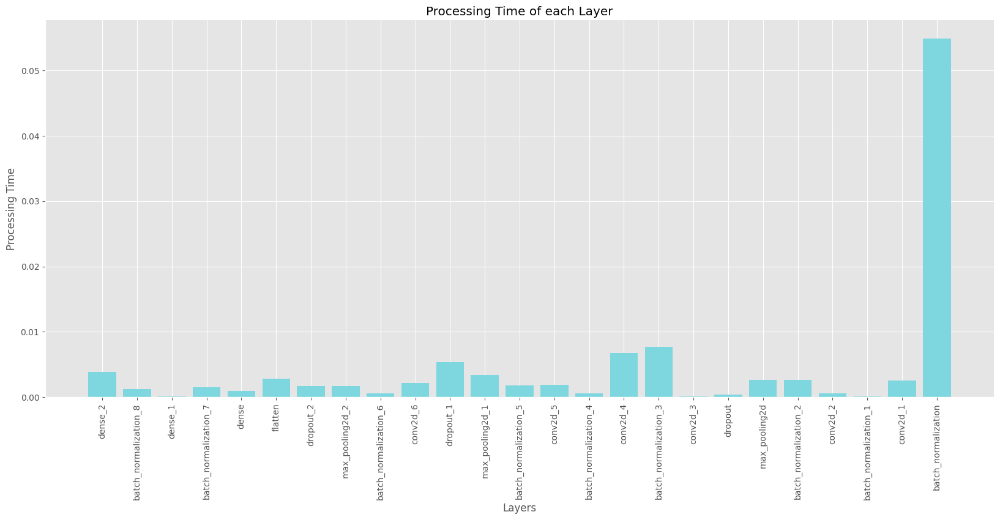

In [ ]:
times = time_per_layer(scratch_model)

# Visualize

import matplotlib.pyplot as plt

plt.style.use('ggplot')
x = [scratch_model.layers[-i].name for i in range(1,len(scratch_model.layers))]

g = [times[i,0] for i in range(1,len(times))]
x_pos = np.arange(len(x))
plt.bar(x, g, color='#7ed6df')
plt.xlabel("Layers")
plt.ylabel("Processing Time")
plt.title("Processing Time of each Layer")
plt.xticks(x_pos, x,rotation=90)

plt.show()

#### **Calculations for Approach2 &3**

In [ ]:
res_model = load_model("/content/drive/MyDrive/Tahaluf_ML_Task/Clothing_Articles_Res_Model.h5")

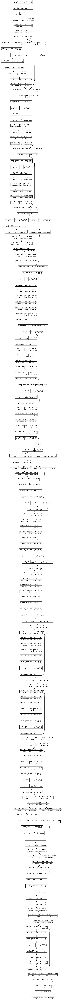

In [ ]:
plot_model(res_model, show_shapes=True, show_layer_names=True) 

In [ ]:
net_flops(res_model,table=True)

               Layer Name |      Input Shape |     Output Shape |      Kernel Size |          Filters | Strides |  FLOPS
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                  input_2 |    [224, 224, 3] |    [224, 224, 3] |           [0, 0] |           [0, 0] | [1, 1] | 0.0000
                conv1_pad |     ['', '', ''] |     ['', '', ''] |           [0, 0] |           [0, 0] | [1, 1] | 0.0000
               conv1_conv |    [230, 230, 3] |   [112, 112, 64] |           (7, 7) |               64 | (2, 2) | 248841600.0000
                 conv1_bn |   [112, 112, 64] |   [112, 112, 64] |           [0, 0] |           [0, 0] | [1, 1] | 0.0000
               conv1_relu |   [112, 112, 64] |   [112, 112, 64] |           [0, 0] |           [0, 0] | [1, 1] | 0.0000
                pool1_pad |     ['', '', ''] |     ['', '', ''] |           [0, 0] |           [0, 0

In [ ]:
matplotlib.rc('figure', figsize = (14, 6))

In [ ]:
times = time_per_layer(res_model)

In [ ]:
import matplotlib.pyplot as plt

plt.style.use('ggplot')
x = [res_model.layers[-i].name for i in range(1,len(res_model.layers))]

g = [times[i,0] for i in range(1,len(times))]

In [ ]:
layers_with_time= list(zip(x,g))

In [ ]:
sorted_layers_with_time = sorted(layers_with_time, key=lambda x: x[1],reverse=True)

print(len(sorted_layers_with_time), sorted_layers_with_time)

177 [('conv3_block3_1_relu', 0.4504263401031494), ('conv3_block3_1_bn', 0.44791412353515625), ('conv1_pad', 0.05095624923706055), ('conv2_block3_1_relu', 0.008091926574707031), ('conv2_block2_2_relu', 0.007600069046020508), ('conv4_block3_1_conv', 0.007241010665893555), ('conv3_block2_2_conv', 0.0071642398834228516), ('conv2_block2_2_bn', 0.006822109222412109), ('conv3_block2_2_bn', 0.0066127777099609375), ('conv2_block1_3_bn', 0.006378889083862305), ('conv2_block1_add', 0.005930900573730469), ('conv4_block1_0_bn', 0.005597352981567383), ('conv4_block2_out', 0.00533604621887207), ('conv2_block3_2_conv', 0.00528717041015625), ('conv5_block2_out', 0.005091190338134766), ('conv4_block6_3_conv', 0.00478363037109375), ('conv4_block1_0_conv', 0.0047760009765625), ('conv5_block3_1_conv', 0.004322052001953125), ('conv4_block3_2_conv', 0.0039844512939453125), ('conv3_block1_0_bn', 0.0038797855377197266), ('conv4_block3_3_conv', 0.0038564205169677734), ('conv3_block2_3_bn', 0.0038471221923828125

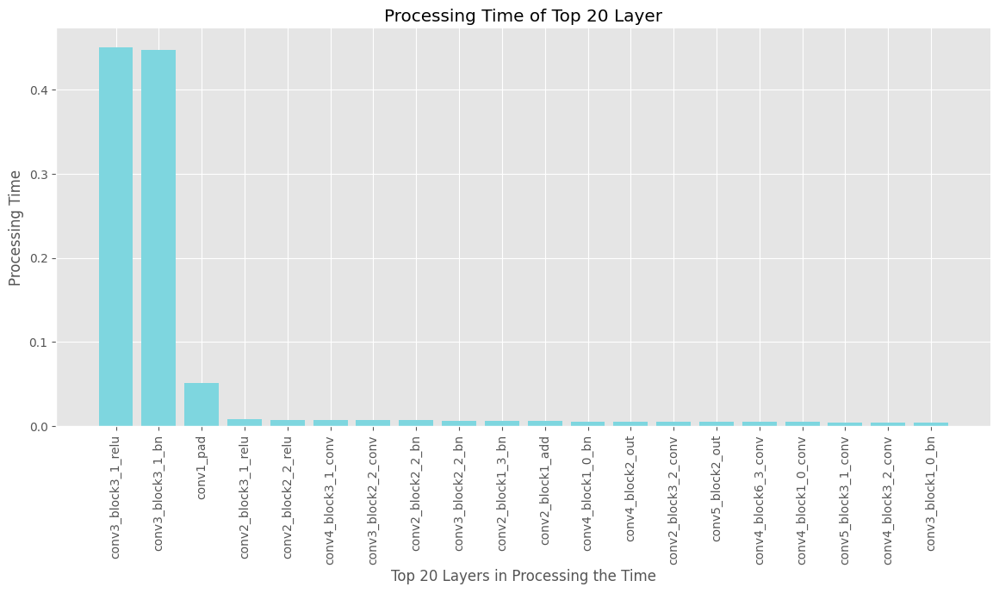

In [ ]:

x_20= [t[0] for t in sorted_layers_with_time][:20]
g_20= [t[1] for t in sorted_layers_with_time][:20]
# Visualize
x_pos = np.arange(len(x_20))
plt.bar(x_20, g_20, color='#7ed6df')
plt.xlabel("Top 20 Layers in Processing the Time")
plt.ylabel("Processing Time")
plt.title("Processing Time of Top 20 Layer")
plt.xticks(x_pos, x_20,rotation=90)

plt.show()

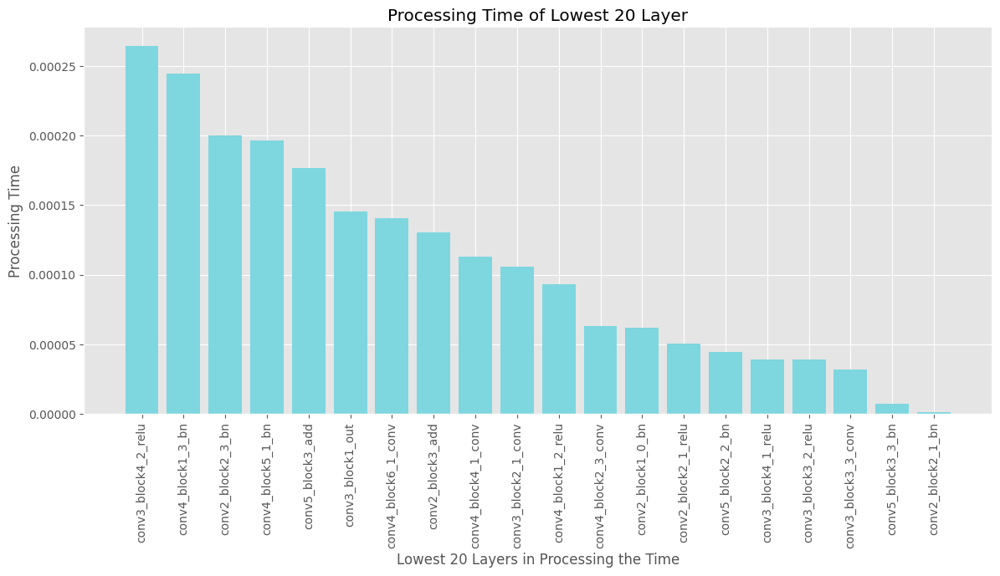

In [ ]:
x_20= [t[0] for t in sorted_layers_with_time][-20:]
g_20= [t[1] for t in sorted_layers_with_time][-20:]
# Visualize
x_pos = np.arange(len(x_20))
plt.bar(x_20, g_20, color='#7ed6df')
plt.xlabel("Lowest 20 Layers in Processing the Time")
plt.ylabel("Processing Time")
plt.title("Processing Time of Lowest 20 Layer")
plt.xticks(x_pos, x_20,rotation=90)

plt.show()

#### **Calculations for Approach4**

In [ ]:
conv_model = load_model('/content/drive/MyDrive/Tahaluf_ML_Task/Clothing_Articles_ConvNext_Model',compile=False)

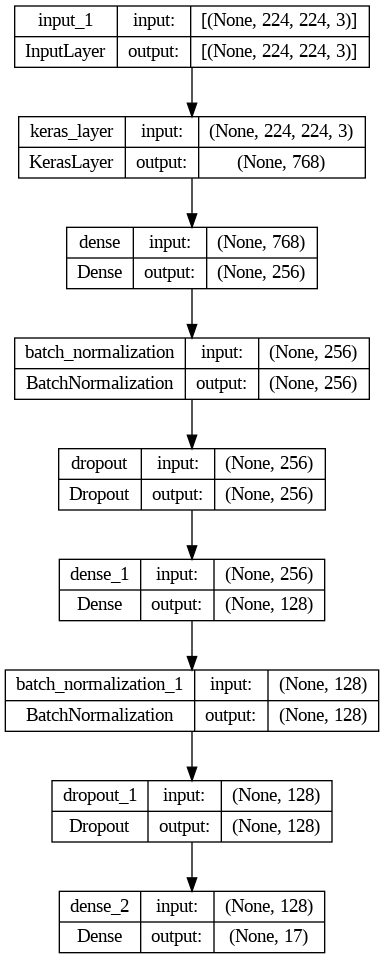

In [ ]:
plot_model(conv_model, show_shapes=True, show_layer_names=True) 

In [ ]:
net_flops(conv_model,table=True)

               Layer Name |      Input Shape |     Output Shape |      Kernel Size |          Filters | Strides |  FLOPS
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                  input_1 |    [224, 224, 3] |    [224, 224, 3] |           [0, 0] |           [0, 0] | [1, 1] | 0.0000
              keras_layer |     ['', '', ''] |     ['', '', ''] |           [0, 0] |           [0, 0] | [1, 1] | 0.0000
KerasTensor(type_spec=TensorSpec(shape=(None, 768), dtype=tf.float32, name=None), name='keras_layer/StatefulPartitionedCall:0', description="created by layer 'keras_layer'")
                    dense |              768 |            [256] |           [0, 0] |           [0, 0] | [1, 1] | 393216.0000
      batch_normalization |            [256] |            [256] |           [0, 0] |           [0, 0] | [1, 1] | 0.0000
                  dropout |     ['', '', ''] |   

In [ ]:
matplotlib.rc('figure', figsize = (14, 6))

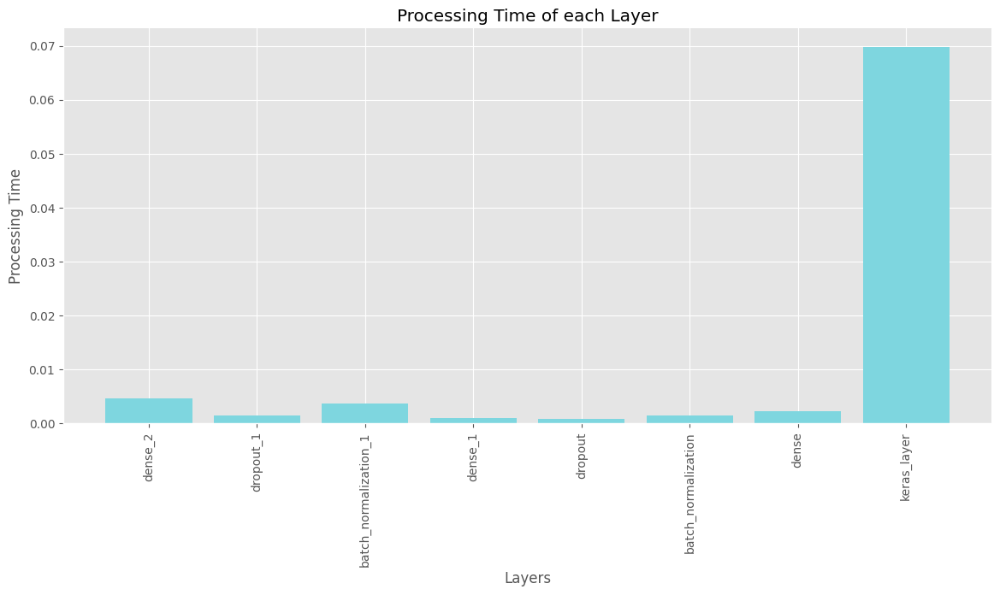

In [ ]:
times = time_per_layer(conv_model)

# Visualize

import matplotlib.pyplot as plt

plt.style.use('ggplot')
x = [conv_model.layers[-i].name for i in range(1,len(conv_model.layers))]

g = [times[i,0] for i in range(1,len(times))]
x_pos = np.arange(len(x))
plt.bar(x, g, color='#7ed6df')
plt.xlabel("Layers")
plt.ylabel("Processing Time")
plt.title("Processing Time of each Layer")
plt.xticks(x_pos, x,rotation=90)

plt.show()